#  Textual Emotions Prediction

# Best Model

*importing required Libraries*

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import nltk
nltk.download('punkt')
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score
from tensorflow.keras.preprocessing.text import Tokenizer
from sklearn.feature_extraction.text import CountVectorizer
from nltk import word_tokenize
import warnings
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Embedding, Dense, LSTM, Bidirectional
from matplotlib import pyplot
!pip install bnlp_toolkit

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')
# %cd /content/drive/MyDrive/Colab Notebooks

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


## Importing & Processing Train Data

In [ ]:
outputSet = []  #trainInput
inputSet = []   #TrainLabel
wordCount = lineCount = maxLen = left = right = 0

with open('/content/drive/MyDrive/Colab Notebooks/train.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        lineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                outputSet.append(temp)

                # if temp == "বিষণ্ণতা" or temp == "সুখী" or temp == "বিতৃষ্ণা" or temp == "বিস্ময়" or temp == "ভয়" or temp == "রাগ":
                    # outputSet.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        if cnt >= 18:
            right += 1
        else:
            left += 1 
        wordCount += cnt
        maxLen = max(maxLen, cnt)  
        str = str.strip(' ')
        inputSet.append(str)


print('Class/Label:',outputSet)
print('Train Data', inputSet)
print('Total Example/Lines: ',len(inputSet))
print('Total word: ',wordCount)

#Median Calculation 
avgWord = int(wordCount/lineCount)
print("\nMedian/Average Word Per Line: ", avgWord)
print("Max Words Per Line: ", maxLen)

print("\nwords per line more than average: ", right)
print("words per line less than average: ", left)

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
trainLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in outputSet]  
trainLabel = np.array(trainLabel)
print('Class/Label:',outputSet)
print('Class/Label (integer):', trainLabel)
print('Total Label/Output: ',len(trainLabel))

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
trainLabel = pd.get_dummies(trainLabel).values
trainLabel = np.array(trainLabel)
print('Shape of label tensor:', trainLabel.shape)
print(trainLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (4700, 6)
[[1 0 0 0 0 0]
 [1 0 0 0 0 0]
 [0 0 0 0 0 1]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


## Importing & Processing Development Data

In [ ]:
devInput = []  #test data
devOutput = [] #test label
devWordCount = devLineCount = devMaxLen = devLeft = devRight = 0

with open('/content/drive/MyDrive/Colab Notebooks/dev.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        devLineCount += 1
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                devOutput.append(temp)
            else:
                str += item+" "
                 
        devWordCount += cnt
        devMaxLen = max(devMaxLen, cnt)  
        str = str.strip(' ')
        devInput.append(str)


print('Development Class/Label:',devOutput)
print('Development Data', devInput)
print('Total Development Example/Lines: ',len(devInput))
print('Total word: ',devWordCount)

#Median Calculation 
devAvgWord = int(devWordCount/devLineCount)
print("\nMedian/Average Word Per Line: ", devAvgWord)
print("Max Words Per Line: ", devMaxLen)

Development Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'র

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
devLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in devOutput]  
devLabel = np.array(devLabel)
print('Class/Label:',devOutput)
print('Class/Label (integer):', devLabel)
print('Total Label/Output: ',len(devLabel))

Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
devLabel = pd.get_dummies(devLabel).values
devLabel = np.array(devLabel)
print('Shape of label tensor:', devLabel.shape)
print(devLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (940, 6)
[[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


#### Testing 

In [ ]:
import nltk
s = inputSet[0]
words = nltk.word_tokenize(s)
# for w in words:
#     print(w)
print(words)
print(len(words))

['বরাবর', ',', 'মাননীয়', 'প্রধানমন্ত্রী', 'গণপ্রজাতন্ত্রী', 'বাংলাদেশ', 'সরকার।', 'মাননীয়', 'প্রধানমন্ত্রী', ',', 'আমি', 'আপনার', 'স্বপ্নের', 'ডিজিটাল', 'বাংলাদেশের', 'স্বপ্ন', 'বুকে', 'লালনকারী', 'একজন', 'সাধারণ', 'ছাত্র।', 'শত', 'সহস্র', 'আশা', 'এবং', 'দেশের', 'প্রতি', 'এক', 'অকৃত্তিম', 'ভালোবাসা', 'এবং', 'নিজেকে', 'দেশের', 'জন্য', 'যোগ্য', 'করে', 'গড়ে', 'তোলার', 'এক', 'তীব্র', 'আকাঙ্ক্ষা', 'নিয়ে', 'ভর্তি', 'হয়েছিলাম', 'আপনার', 'নিজ', 'হাতে', 'প্রতিষ্ঠিত', 'দেশের', 'অন্যতম', 'বিশ্ববিদ্যালয়', 'যশোর', 'বিজ্ঞান', 'ও', 'প্রযুক্তি', 'বিশ্ববিদ্যালয়ে।', 'একটি', 'ডিজিটাল', 'বাংলাদেশ', 'গড়তে', 'এ', 'ধরণের', 'একটি', 'প্রযুক্তি', 'বিশ্ববিদ্যালয়', 'প্রতিষ্ঠা', 'করা', 'নিঃসন্দেহে', 'আপনার', 'দেশ', 'পরিচালনার', 'একটি', 'বিচক্ষণতার', 'পরিচয়', 'বহন', 'করে।', 'আপনি', 'যশোর', 'বাসির', 'স্বপ্নের', 'এই', 'প্রতিষ্ঠানে', 'শত', 'শত', 'কোটি', 'টাকা', 'বিনিয়োগ', 'করেছেন', 'দুহাত', 'উজাড়', 'করে।', 'কিন্তু', 'অত্যন্ত', 'দুঃখের', 'সাথে', 'সেই', 'বিশ্ববিদ্যালয়', 'জীবনের', 'সূচনালগ্ন', 'থেকে', 'অনুভব

## Text Processing 

### Bn Stop Word removal From Train Data

In [ ]:
from bnlp.corpus import stopwords, punctuations
from bnlp.corpus.util import remove_stopwords

inputSet_stopword_removed = []
for line in inputSet:
    # Stopwords being removed from this line
    result1 = remove_stopwords(line, stopwords)
    cnt = 0
    lineMod = ""
    for word in result1:
        # print(word)
        # cnt += 1
        lineMod += word+' '

    # punctuations being removed from this line
    result2 = remove_stopwords(lineMod, punctuations)
    lineMod = ""
    for word in result2:
        # print(word)
        cnt += 1
        lineMod += word+' '
    inputSet_stopword_removed.append(lineMod)
    # print(lineMod1)
    # print(lineMod2)
    # print(cnt)

print(inputSet)
print(inputSet_stopword_removed)
inputSet = inputSet_stopword_removed

/usr/local/lib/python3.7/dist-packages/gensim/similarities/__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


['বরাবর, মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার। মাননীয় প্রধানমন্ত্রী, আমি আপনার স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন সাধারণ ছাত্র। শত সহস্র আশা এবং দেশের প্রতি এক অকৃত্তিম ভালোবাসা এবং নিজেকে দেশের জন্য যোগ্য করে গড়ে তোলার এক তীব্র আকাঙ্ক্ষা নিয়ে ভর্তি হয়েছিলাম আপনার নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান ও প্রযুক্তি বিশ্ববিদ্যালয়ে। একটি ডিজিটাল বাংলাদেশ গড়তে এ ধরণের একটি প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা করা নিঃসন্দেহে আপনার দেশ পরিচালনার একটি বিচক্ষণতার পরিচয় বহন করে। আপনি যশোর বাসির স্বপ্নের এই প্রতিষ্ঠানে শত শত কোটি টাকা বিনিয়োগ করেছেন দুহাত উজাড় করে। কিন্তু অত্যন্ত দুঃখের সাথে সেই বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন থেকে অনুভব করছি যে, অনেক পাওয়ার আনন্দে যখন শিক্ষার্থীদের মনপ্রান উজাড় করে পড়ালেখা করার কথা, তার বিপরীতে এই কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত করছে প্রাণ নাশের হুমকি, শ্লীলতাহানীর গ্লানি, আর ছাত্রত্ত বাতিল হওয়ার হুমকি নিয়ে। সম্মানিত শিক্ষকদের কে মারতে যাওয়া, গলা কেটে ফেলার হুমকি, প্রাণ নাশের হুমকি, কটূক্তি 

### Bn Stop Word removal From Development Data

In [ ]:
from bnlp.corpus import stopwords, punctuations
from bnlp.corpus.util import remove_stopwords

devOutputSet_stopword_removed = []
for line in devInput:
    # Stopwords being removed from this line
    result1 = remove_stopwords(line, stopwords)
    cnt = 0
    lineMod = ""
    for word in result1:
        # print(word)
        # cnt += 1
        lineMod += word+' '

    # punctuations being removed from this line
    result2 = remove_stopwords(lineMod, punctuations)
    lineMod = ""
    for word in result2:
        # print(word)
        cnt += 1
        lineMod += word+' '
    devOutputSet_stopword_removed.append(lineMod)
    # print(lineMod1)
    # print(lineMod2)
    # print(cnt)

print(devInput)
print(devOutputSet_stopword_removed)
devInput = devOutputSet_stopword_removed

['আল্লাও তো তার ঘর মসজিদকে রক্ষা করতে পারে না তাহলে কি আল্লা নেই??', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো??? আশ্চর্য হলাম, যে দেবতা নিজেকে নিজে রক্ষা করতে পারেনা সে অন্যদের কিভাবে রক্ষা করবে?', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস ও দেখলামনা। অতছ এখন.... হায়রে মানুষ???', 'আপনি কি প্রমান দিতে পারবেন আপনার টা সঠিক।', 'ইমরান ভাই অাপনি যদি মুসলমান হতেন তাহলে অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ,,,,,,,,,,,,,,,?', 'আমার মনে হয় প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ কে অস্থির করার জন্য কনো মুসলমান এটা করতে পারেনা', 'ইমরান বুঝে নিও।।। কোন এক দিন শুনতে পাব তোমারও গাড়ে মাথা নেই এই মুর্তি মত', 'এখন কোথায় হেফাজত ইসলাম এর সেই নেতা?যে বলে সংখালঘুরা নিরাপদে আছে?', 'আপনার সবাই গালি দেয় কেন?', 'এরা তো নিজেদেরকেই রক্ষা করতে পারে না। তবে তাদের সৃষ্টিকে কিভাবে রক্ষা করবে?', 'ভাই আপনি কি হিন্দু না মুসলমান', 'যখন ভারতের মুসলমানের উপর অত্যচার হয় তখন তো কেউ বলে না ।', 'এদেও এক দিন বিচার হবে ।হয় তো আমরা দেখতে পারবনা।।', 'আমার মনে হয় ইমরান কুমার শিল নিজেই এগুলো ভেঙেছে তা ছাড়া ছবি তুললেন কি ভাবে', 'আমি আ

## Tokenization for Training

In [ ]:
# tokenization 
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(inputSet)

# converting words into sequences

print('Raw input: ',inputSet)
print('Unique words/tokens: ',tokenizer.word_index)

Raw input:  ['বরাবর মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার মাননীয় প্রধানমন্ত্রী স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন ছাত্র শত সহস্র আশা দেশের এক অকৃত্তিম ভালোবাসা নিজেকে দেশের যোগ্য গড়ে তোলার এক তীব্র আকাঙ্ক্ষা ভর্তি হয়েছিলাম নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান প্রযুক্তি বিশ্ববিদ্যালয়ে ডিজিটাল বাংলাদেশ গড়তে ধরণের প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা নিঃসন্দেহে দেশ পরিচালনার বিচক্ষণতার পরিচয় বহন যশোর বাসির স্বপ্নের প্রতিষ্ঠানে শত শত টাকা বিনিয়োগ দুহাত উজাড় অত্যন্ত দুঃখের সাথে বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন অনুভব করছি পাওয়ার আনন্দে শিক্ষার্থীদের মনপ্রান উজাড় পড়ালেখা কথা বিপরীতে কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত প্রাণ নাশের হুমকি শ্লীলতাহানীর গ্লানি ছাত্রত্ত বাতিল হুমকি সম্মানিত শিক্ষকদের মারতে গলা কেটে ফেলার হুমকি প্রাণ নাশের হুমকি কটূক্তি নিয়মিত ঘটনা মাননীয় প্রধানমন্ত্রী শিক্ষার্থীরা শিক্ষকদের পিতামাতার মত সম্মান একজন চতুর্থ শ্রেণীর কর্মচারীর শিক্ষকদের নিয়মিত ঘটনার শিকার ডিজিটাল বাংলাদেশের স্বপ্নে পাক হানাদার বাহিনীর মত

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_train_ex = tokenizer.texts_to_sequences(inputSet)

print('Inputs after being converted: ',dense_train_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_train_ex))

Inputs after being converted:  [[3974, 1373, 220, 6210, 32, 18, 1373, 220, 2889, 487, 54, 854, 667, 6211, 30, 488, 725, 3975, 93, 19, 16, 6212, 668, 205, 19, 855, 3976, 6213, 16, 566, 6214, 2333, 6215, 460, 116, 3977, 19, 1374, 1853, 2334, 787, 2335, 3978, 487, 32, 3979, 1375, 2335, 1853, 1854, 2336, 26, 6216, 6217, 6218, 2337, 2334, 6219, 2889, 2890, 725, 725, 17, 6220, 6221, 3980, 1855, 1856, 6, 1853, 669, 6222, 3981, 61, 6223, 1376, 3982, 6224, 3980, 6225, 2, 2891, 6226, 3983, 2338, 6227, 1568, 2339, 417, 6228, 6229, 6230, 362, 417, 1857, 1377, 2892, 331, 489, 3984, 417, 1568, 2339, 417, 6231, 3985, 221, 1373, 220, 3983, 1377, 6232, 15, 281, 30, 6233, 3986, 6234, 1377, 3985, 856, 946, 487, 54, 6235, 947, 6236, 857, 15, 3987, 670, 461, 1196, 6237, 74, 2893, 3982, 206, 222, 948, 6238, 726, 2, 6239, 136, 1062, 3978, 6240, 2340, 6241, 1197, 3988, 6242, 1377, 2341, 3989, 243, 6243, 1063, 6244, 2341, 2894, 3990, 3991, 2889, 462, 77, 6245, 2895, 6246, 1373, 220, 949, 6247, 6248, 6249, 2342

## Tokenization for Dev

In [ ]:
# tokenization 
tokenizerDev = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizerDev.fit_on_texts(devInput)

# converting words into sequences
print('Raw input: ',devInput)
print('Unique words/tokens: ',tokenizerDev.word_index)

Raw input:  ['আল্লাও ঘর মসজিদকে রক্ষা আল্লা ', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো আশ্চর্য হলাম দেবতা নিজেকে রক্ষা পারেনা অন্যদের কিভাবে রক্ষা ', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস দেখলামনা অতছ হায়রে মানুষ ', 'প্রমান পারবেন টা সঠিক ', 'ইমরান ভাই অাপনি মুসলমান হতেন অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ', 'প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ অস্থির কনো মুসলমান পারেনা ', 'ইমরান বুঝে নিও এক শুনতে পাব তোমারও গাড়ে মাথা মুর্তি মত ', 'কোথায় হেফাজত ইসলাম নেতা সংখালঘুরা নিরাপদে ', 'সবাই গালি দেয় ', 'নিজেদেরকেই রক্ষা সৃষ্টিকে কিভাবে রক্ষা ', 'ভাই হিন্দু মুসলমান ', 'ভারতের মুসলমানের অত্যচার ', 'এদেও এক বিচার পারবনা ', 'ইমরান কুমার শিল এগুলো ভেঙেছে ছবি তুললেন ', 'আরো বলছি তাদেরকে একটা সারপ্রাইজ দেওয়ার দরকার শফিক ', 'ধর্ম বিশ্বাস ধার্মিক ধর্ম বোজেন সঠিক মানবে তাহারা কখনো আন্যায় করিবেননা ', 'ভাই মতে টা ', 'দেশে মানুষ খুনের বিচার পাওয়া যায় দেশে মুর্তি ভাঙ্গার বিচার ', 'মুয়াজ্জিন হত্যার বিচার চেয়ে স্টাটাস লিখেছেন ', 'এইভাবে অন্যর ধর্ম বিশ্বাসের আঘাত ধর্মমতকে মহান মাহত্ম❕❔ ', 'এগুলো কারা কারা

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_dev_ex = tokenizerDev.texts_to_sequences(devInput)

print('Inputs after being converted: ',dense_dev_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_dev_ex))

Inputs after being converted:  [[861, 470, 862, 151, 863], [90, 864, 57, 471, 472, 299, 865, 300, 473, 67, 151, 121, 474, 91, 151], [35, 214, 866, 14, 867, 868, 869, 475, 4], [301, 302, 50, 215], [5, 3, 216, 38, 870, 216, 871, 76, 7, 50, 872, 873], [32, 40, 104, 476, 477, 20, 478, 874, 38, 121], [5, 303, 875, 24, 479, 876, 877, 878, 57, 217, 41], [105, 304, 42, 480, 879, 880], [61, 152, 106], [881, 151, 882, 91, 151], [3, 21, 38], [481, 883, 884], [885, 24, 7, 886], [5, 887, 888, 68, 104, 218, 889], [92, 153, 154, 14, 890, 219, 43, 891], [9, 69, 155, 9, 892, 215, 893, 894, 107, 895, 896], [3, 897, 50], [16, 4, 482, 7, 220, 44, 16, 217, 483, 7], [35, 76, 7, 898, 305, 899], [221, 484, 9, 900, 17, 901, 156, 902], [68, 93, 93, 306, 157, 158, 903, 904], [905, 67, 485, 906, 907, 908, 159], [486, 91, 909, 487, 20], [8, 122, 488, 160, 22, 307, 910], [68, 911, 912], [913, 489, 123, 124, 16, 51], [914, 308, 222, 223], [33, 161], [309, 7, 224, 915], [490, 916], [491, 917, 77, 492, 918, 919], [4, 

## Rapid testing

In [ ]:
x = 0
for line in dense_train_ex:
    for word in line:
        x = max(x,word)
print(x)

# print(max(dense_train_ex))

17261


## Unique word /vocab size init 1

In [ ]:
# x = 0
# for line in dense_dev_ex:
#     for word in line:
#         x = max(x,word)
# uniqueWord = x
# print(x)

# print(max(dense_train_ex))

## Unique word /vocab size init 2

In [ ]:
vectorized = CountVectorizer(encoding='utf-8', tokenizer=word_tokenize)
vectorized.fit_transform(inputSet)

wordList = vectorized.get_feature_names()
uniqueWord = len(wordList)
print('Unique words: ',wordList)
print('Total Unique words: ',uniqueWord)

Unique words:  ['0', '0000000', '01626511109', '01795280807', '03', '04', '1', '10', '100', '10000', '10150251565832269', '10153832472312269', '1055060641174791', '106800', '11', '1100', '1101826526522067', '12', '13কোটি', '14', '140643', '1439211256321712', '146161', '15', '153106', '16', '1698026070471556', '179379108907488', '18', '1newsbd', '1st', '1upfb6q2', '1z5nsvfzgvqbcnyw0gv5t4k1ma95924kip8j0rrwfpww', '2', '200', '2006', '2010', '2013', '2015', '2016', '20588', '21', '22', '23', '23646', '24', '241494299221965', '27777', '29', '2a', '2nd', '3', '30', '30070096', '30071294', '30084890', '31', '339029', '346510', '347617', '374678', '3cetdc', '3d', '3y08p7', '4', '40', '4000', '440969819444535', '47রাখস', '5', '500', '5000', '510113745860941', '52', '53933', '56581', '586449788140511', '6', '6000', '610309312431667', '669192268', '7', '71', '719109314874557', '71tv♦', '71কে', '734342866684535', '772314402791108', '79911', '80', '81', '82', '83', '835', '8443', '86', '87', '87051

### Padding Train Data

In [ ]:
MAX_LENGTH_TRAIN = avgWord+20
print('Max Length: ',MAX_LENGTH_TRAIN)

paddedTrainData = pad_sequences(dense_train_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedTrainData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  37
[[  610  6256  3994 ...   787  2335  1853]
 [  671   244  1570 ...     0     0     0]
 [ 6272  4000  6273 ...     0     0     0]
 ...
 [  749  1285 15370 ...     0     0     0]
 [    5     1    23 ...     0     0     0]
 [ 3799   706  3664 ...    37  2275   801]]


### Padding Dev Data

In [ ]:
MAX_LENGTH_DEV = devAvgWord+10
print('Max Length: ',MAX_LENGTH_DEV)

paddedDevData = pad_sequences(dense_dev_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedDevData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  20
[[ 861  470  862 ...    0    0    0]
 [  90  864   57 ...    0    0    0]
 [  35  214  866 ...    0    0    0]
 ...
 [3055  103  290 ...    0    0    0]
 [   6 3057  292 ...    0    0    0]
 [3058 3059    5 ...    0    0    0]]


## Model 

### LSTM

In [ ]:
# Model Declaration
VOCAB_SIZE = uniqueWord+1
model = Sequential()

# Embedding Layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
model.add(embedding_layer)

# LSTM
# forwardLayers = LSTM(units=128, input_shape=(np.shape(paddedTrainData)), activation='relu', return_sequences=True)
# hiddenLayer1 = LSTM(units=256, activation='relu', return_sequences=True)
# hiddenLayer2 = LSTM(units=128, activation='relu', return_sequences=True)
hiddenLayer3 = LSTM(units=128, activation='relu', return_sequences=False)
# model.add(hiddenLayer1)
# model.add(hiddenLayer2)
model.add(hiddenLayer3)

# model.add(Dense(units=64))
# model.add(Dense(units=32))
# model.add(Dense(units=16))
model.add(Dense(units=6, activation='softmax'))
# Output Layer
# model.compile(optimizer='adam', loss='mse', metrics=['acc'])
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['acc'])
model.compile(optimizer='Adam', loss='binary_crossentropy', metrics=['acc'])
print(model.summary())

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_7 (Embedding)      (None, 37, 10)            153970    
_________________________________________________________________
lstm_11 (LSTM)               (None, 128)               71168     
_________________________________________________________________
dense_7 (Dense)              (None, 6)                 774       
Total params: 225,912
Trainable params: 225,912
Non-trainable params: 0
_________________________________________________________________
None


### Bidirectional LSTM

In [ ]:
# Model Declaration
# VOCAB_SIZE = uniqueWord+1

# model = Sequential()

# Embedding Layer
# embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
# model.add(embedding_layer)

# Bidirectional LSTM
# forwardLayers = LSTM(units=128, input_shape=(np.shape(paddedTrainData)), activation='relu', return_sequences=False)
# forwardLayers = LSTM(units=128, return_sequences=False)
# backwardLayers = LSTM(units=128, return_sequences=False, go_backwards=True)
# model.add(Bidirectional(layer=forwardLayers,  backward_layer=backwardLayers))

# Output Layer
# model.add(Dense(units=6, activation='relu'))
# model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc'])
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['acc'])
# model.compile(optimizer='adam', loss='mse', metrics=['acc'])
# print(model.summary())

In [ ]:
# print(np.shape(paddedTrainData))
# print(np.shape(trainLabel))
# print(type(paddedTrainData))
# print(type(trainLabel))

## Engine

In [ ]:
hist = model.fit(paddedTrainData, trainLabel, validation_data=(paddedDevData, devLabel), epochs=20, verbose=1)

Epoch 1/20
147/147 [==============================] - 7s 40ms/step - loss: 0.4561 - acc: 0.2760 - val_loss: 0.4222 - val_acc: 0.3191
Epoch 2/20
147/147 [==============================] - 6s 38ms/step - loss: 0.4080 - acc: 0.3438 - val_loss: 0.6856 - val_acc: 0.3330
Epoch 3/20
147/147 [==============================] - 6s 38ms/step - loss: 0.3566 - acc: 0.4374 - val_loss: 0.5850 - val_acc: 0.3149
Epoch 4/20
147/147 [==============================] - 6s 39ms/step - loss: 0.3080 - acc: 0.5094 - val_loss: 0.6098 - val_acc: 0.3053
Epoch 5/20
147/147 [==============================] - 6s 39ms/step - loss: 0.2769 - acc: 0.5419 - val_loss: 0.6638 - val_acc: 0.2670
Epoch 6/20
147/147 [==============================] - 6s 39ms/step - loss: 0.2507 - acc: 0.6251 - val_loss: 0.7424 - val_acc: 0.2947
Epoch 7/20
147/147 [==============================] - 6s 39ms/step - loss: 0.2214 - acc: 0.6860 - val_loss: 0.9136 - val_acc: 0.3043
Epoch 8/20
147/147 [==============================] - 6s 39ms/step - 

### Plotting Loss-Accuracy

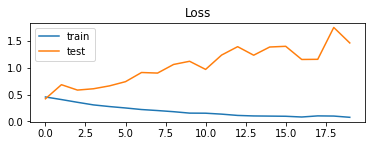

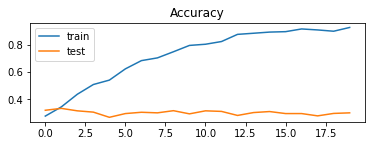

In [ ]:
pyplot.subplot(211)
pyplot.title('Loss')
pyplot.plot(hist.history['loss'], label='train')
pyplot.plot(hist.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

pyplot.subplot(211)
pyplot.title('Accuracy')
pyplot.plot(hist.history['acc'], label='train')
pyplot.plot(hist.history['val_acc'], label='test')
pyplot.legend()
pyplot.show()

## **Evaluation/Auto Prediction**

In [ ]:
developmentPrediction = model.evaluate(paddedDevData, devLabel, verbose=1)
print('Dev Prediction: ', np.round(developmentPrediction[1]*100, 2) ,' %')

30/30 [==============================] - 0s 12ms/step - loss: 1.4661 - acc: 0.3000
Dev Prediction:  30.0  %


## **Manual Prediction**

In [ ]:
yprime = model.predict(paddedDevData)
print('Predicted Label:\n\n',yprime) 
y = devLabel               
print('\nActual Label:\n\n',y)                

Predicted Label:

 [[1.0287828e-03 9.9716240e-01 3.6529926e-04 9.0535393e-04 3.1158130e-04
  2.2659289e-04]
 [5.2045757e-11 1.0000000e+00 3.3630115e-12 3.4588882e-16 4.2534912e-12
  1.1949916e-14]
 [9.9000400e-01 7.6467765e-04 5.3014950e-04 1.6989337e-03 2.3467686e-04
  6.7676236e-03]
 ...
 [9.9509561e-01 6.3518609e-04 6.1538874e-04 1.3728043e-03 1.8931432e-04
  2.0916003e-03]
 [1.6861736e-04 7.7676385e-05 1.0101284e-04 3.7577594e-04 1.4534546e-04
  9.9913162e-01]
 [5.1410538e-03 5.5601326e-04 5.3234928e-04 7.3943922e-04 4.6013601e-04
  9.9257106e-01]]

Actual Label:

 [[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


### Accuracy

In [ ]:
yprime = np.round(yprime.reshape(-1))
print('Predicted Output:\n', yprime)

y = np.round(y.reshape(-1))
print('actual Output:\n', y)

print('Accuracy Score: ',np.round(accuracy_score(y, yprime)*100 , 2), '%')

Predicted Output:
 [0. 0. 0. ... 0. 0. 0.]
actual Output:
 [0 0 0 ... 0 0 0]
Accuracy Score:  80.48 %


## **Confusion Matrix**

In [ ]:
expected = y
predicted = yprime
results = confusion_matrix(expected, predicted)
print(results)

[[4053  647]
 [ 662  278]]


## **F1 score**


In [ ]:
f1 = f1_score(y, yprime,average='micro')
print('F1 score: %f' % f1)

F1 score: 0.804787


## Export Output

decoding loss/acc data to string

In [ ]:
# print(type(hist.history))
# print(hist.history)
# print(hist.history['acc'])
strLine = "Accuracy: "
for x in hist.history['acc']:
    t = np.format_float_positional(x)
    strLine += t+" "

strLine += "\n\nLoss: "
for x in hist.history['loss']:
    t = np.format_float_positional(x)
    strLine += t+" "

strLine += "\n\nValidation Accuracy: "
for x in hist.history['val_acc']:
    t = np.format_float_positional(x)
    strLine += t+" "

strLine += "\n\nValidation Loss: "
for x in hist.history['val_loss']:
    t = np.format_float_positional(x)
    strLine += t+" "
    
print(strLine)

Accuracy: 0.2759574353694916 0.34382978081703186 0.43744680285453796 0.5093616843223572 0.5419148802757263 0.6251063942909241 0.6859574317932129 0.7061702013015747 0.7514893412590027 0.7982978820800781 0.8070212602615356 0.8270213007926941 0.8799999952316284 0.8882978558540344 0.8968085050582886 0.8999999761581421 0.9200000166893005 0.9127659797668457 0.9031915068626404 0.9310638308525085 

Loss: 0.4561026990413666 0.40795502066612244 0.3566109836101532 0.3079669177532196 0.276935338973999 0.2506568431854248 0.2213856279850006 0.20234879851341248 0.1809847354888916 0.1543477475643158 0.15274709463119507 0.13532879948616028 0.1112152636051178 0.10155898332595825 0.09863781929016113 0.0954853966832161 0.08173109591007233 0.10257373750209808 0.09934918582439423 0.07609403878450394 

Validation Accuracy: 0.3191489279270172 0.3329787254333496 0.31489360332489014 0.3053191602230072 0.2670212686061859 0.2946808636188507 0.30425530672073364 0.30000001192092896 0.3159574568271637 0.292553186416

one time use only 

In [ ]:
# !touch "/content/gdrive/My Drive/Colab Notebooks/output.txt" 

writing output.txt file

In [ ]:
with open('/content/drive/MyDrive/Colab Notebooks/output.txt', 'w') as writefile:
    writefile.write(strLine)

# Stable Model

*importing required Libraries*

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import nltk
nltk.download('punkt')
from tensorflow.keras.preprocessing.text import Tokenizer
from sklearn.feature_extraction.text import CountVectorizer
from nltk import word_tokenize
import warnings
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Embedding, Dense, LSTM, Bidirectional
from matplotlib import pyplot as pp
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score
!pip install bnlp_toolkit

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')
# %cd /content/drive/MyDrive/Colab Notebooks

## Importing & Processing Train Data

In [ ]:
outputSet = []
inputSet = []
wordCount = lineCount = maxLen = left = right = 0

with open('/content/drive/MyDrive/Colab Notebooks/train.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        lineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                outputSet.append(temp)

                # if temp == "বিষণ্ণতা" or temp == "সুখী" or temp == "বিতৃষ্ণা" or temp == "বিস্ময়" or temp == "ভয়" or temp == "রাগ":
                    # outputSet.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        if cnt >= 18:
            right += 1
        else:
            left += 1 
        wordCount += cnt
        maxLen = max(maxLen, cnt)  
        str = str.strip(' ')
        inputSet.append(str)


print('Class/Label:',outputSet)
print('Train Data', inputSet)
print('Total Example/Lines: ',len(inputSet))
print('Total word: ',wordCount)

#Median Calculation 
avgWord = int(wordCount/lineCount)
print("\nMedian/Average Word Per Line: ", avgWord)
print("Max Words Per Line: ", maxLen)

print("\nwords per line more than average: ", right)
print("words per line less than average: ", left)

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
trainLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in outputSet]  
trainLabel = np.array(trainLabel)
print('Class/Label:',outputSet)
print('Class/Label (integer):', trainLabel)
print('Total Label/Output: ',len(trainLabel))

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
trainLabel = pd.get_dummies(trainLabel).values
trainLabel = np.array(trainLabel)
print('Shape of label tensor:', trainLabel.shape)
print(trainLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (4700, 6)
[[1 0 0 0 0 0]
 [1 0 0 0 0 0]
 [0 0 0 0 0 1]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


## Importing & Processing Development Data

In [ ]:
devInput = []
devOutput = []
devWordCount = devLineCount = devMaxLen = devLeft = devRight = 0

with open('/content/drive/MyDrive/Colab Notebooks/dev.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        devLineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                devOutput.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        # if cnt >= 18:
        #     devRight += 1
        # else:
        #     devLeft += 1 
        devWordCount += cnt
        devMaxLen = max(devMaxLen, cnt)  
        str = str.strip(' ')
        devInput.append(str)


print('Development Class/Label:',devOutput)
print('Development Data', devInput)
print('Total Development Example/Lines: ',len(devInput))
print('Total word: ',devWordCount)

#Median Calculation 
devAvgWord = int(devWordCount/devLineCount)
print("\nMedian/Average Word Per Line: ", devAvgWord)
print("Max Words Per Line: ", devMaxLen)

# print("\nwords per line more than average: ", right)
# print("words per line less than average: ", left)

Development Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'র

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
devLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in devOutput]  
devLabel = np.array(devLabel)
print('Class/Label:',devOutput)
print('Class/Label (integer):', devLabel)
print('Total Label/Output: ',len(devLabel))

Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
devLabel = pd.get_dummies(devLabel).values
devLabel = np.array(devLabel)
print('Shape of label tensor:', devLabel.shape)
print(devLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (940, 6)
[[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


#### Testing 

In [ ]:
import nltk
s = inputSet[0]
words = nltk.word_tokenize(s)
# for w in words:
#     print(w)
print(words)
print(len(words))

## Text Processing 

### Bn Stop Word removal From Train Data

In [ ]:
from bnlp.corpus import stopwords, punctuations
from bnlp.corpus.util import remove_stopwords

inputSet_stopword_removed = []
for line in inputSet:
    # Stopwords being removed from this line
    result1 = remove_stopwords(line, stopwords)
    cnt = 0
    lineMod = ""
    for word in result1:
        # print(word)
        # cnt += 1
        lineMod += word+' '

    # punctuations being removed from this line
    result2 = remove_stopwords(lineMod, punctuations)
    lineMod = ""
    for word in result2:
        # print(word)
        cnt += 1
        lineMod += word+' '
    inputSet_stopword_removed.append(lineMod)
    # print(lineMod1)
    # print(lineMod2)
    # print(cnt)

print(inputSet)
print(inputSet_stopword_removed)
inputSet = inputSet_stopword_removed

['বরাবর, মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার। মাননীয় প্রধানমন্ত্রী, আমি আপনার স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন সাধারণ ছাত্র। শত সহস্র আশা এবং দেশের প্রতি এক অকৃত্তিম ভালোবাসা এবং নিজেকে দেশের জন্য যোগ্য করে গড়ে তোলার এক তীব্র আকাঙ্ক্ষা নিয়ে ভর্তি হয়েছিলাম আপনার নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান ও প্রযুক্তি বিশ্ববিদ্যালয়ে। একটি ডিজিটাল বাংলাদেশ গড়তে এ ধরণের একটি প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা করা নিঃসন্দেহে আপনার দেশ পরিচালনার একটি বিচক্ষণতার পরিচয় বহন করে। আপনি যশোর বাসির স্বপ্নের এই প্রতিষ্ঠানে শত শত কোটি টাকা বিনিয়োগ করেছেন দুহাত উজাড় করে। কিন্তু অত্যন্ত দুঃখের সাথে সেই বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন থেকে অনুভব করছি যে, অনেক পাওয়ার আনন্দে যখন শিক্ষার্থীদের মনপ্রান উজাড় করে পড়ালেখা করার কথা, তার বিপরীতে এই কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত করছে প্রাণ নাশের হুমকি, শ্লীলতাহানীর গ্লানি, আর ছাত্রত্ত বাতিল হওয়ার হুমকি নিয়ে। সম্মানিত শিক্ষকদের কে মারতে যাওয়া, গলা কেটে ফেলার হুমকি, প্রাণ নাশের হুমকি, কটূক্তি 

### Bn Stop Word removal From Development Data

In [ ]:
from bnlp.corpus import stopwords, punctuations
from bnlp.corpus.util import remove_stopwords

devOutputSet_stopword_removed = []
for line in devInput:
    # Stopwords being removed from this line
    result1 = remove_stopwords(line, stopwords)
    cnt = 0
    lineMod = ""
    for word in result1:
        # print(word)
        # cnt += 1
        lineMod += word+' '

    # punctuations being removed from this line
    result2 = remove_stopwords(lineMod, punctuations)
    lineMod = ""
    for word in result2:
        # print(word)
        cnt += 1
        lineMod += word+' '
    devOutputSet_stopword_removed.append(lineMod)
    # print(lineMod1)
    # print(lineMod2)
    # print(cnt)

print(devInput)
print(devOutputSet_stopword_removed)
devInput = devOutputSet_stopword_removed

['আল্লাও তো তার ঘর মসজিদকে রক্ষা করতে পারে না তাহলে কি আল্লা নেই??', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো??? আশ্চর্য হলাম, যে দেবতা নিজেকে নিজে রক্ষা করতে পারেনা সে অন্যদের কিভাবে রক্ষা করবে?', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস ও দেখলামনা। অতছ এখন.... হায়রে মানুষ???', 'আপনি কি প্রমান দিতে পারবেন আপনার টা সঠিক।', 'ইমরান ভাই অাপনি যদি মুসলমান হতেন তাহলে অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ,,,,,,,,,,,,,,,?', 'আমার মনে হয় প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ কে অস্থির করার জন্য কনো মুসলমান এটা করতে পারেনা', 'ইমরান বুঝে নিও।।। কোন এক দিন শুনতে পাব তোমারও গাড়ে মাথা নেই এই মুর্তি মত', 'এখন কোথায় হেফাজত ইসলাম এর সেই নেতা?যে বলে সংখালঘুরা নিরাপদে আছে?', 'আপনার সবাই গালি দেয় কেন?', 'এরা তো নিজেদেরকেই রক্ষা করতে পারে না। তবে তাদের সৃষ্টিকে কিভাবে রক্ষা করবে?', 'ভাই আপনি কি হিন্দু না মুসলমান', 'যখন ভারতের মুসলমানের উপর অত্যচার হয় তখন তো কেউ বলে না ।', 'এদেও এক দিন বিচার হবে ।হয় তো আমরা দেখতে পারবনা।।', 'আমার মনে হয় ইমরান কুমার শিল নিজেই এগুলো ভেঙেছে তা ছাড়া ছবি তুললেন কি ভাবে', 'আমি আ

## Tokenization for Training

In [ ]:
# tokenization 
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(inputSet)

# converting words into sequences

print('Raw input: ',inputSet)
print('Unique words/tokens: ',tokenizer.word_index)

Raw input:  ['বরাবর মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার মাননীয় প্রধানমন্ত্রী স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন ছাত্র শত সহস্র আশা দেশের এক অকৃত্তিম ভালোবাসা নিজেকে দেশের যোগ্য গড়ে তোলার এক তীব্র আকাঙ্ক্ষা ভর্তি হয়েছিলাম নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান প্রযুক্তি বিশ্ববিদ্যালয়ে ডিজিটাল বাংলাদেশ গড়তে ধরণের প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা নিঃসন্দেহে দেশ পরিচালনার বিচক্ষণতার পরিচয় বহন যশোর বাসির স্বপ্নের প্রতিষ্ঠানে শত শত টাকা বিনিয়োগ দুহাত উজাড় অত্যন্ত দুঃখের সাথে বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন অনুভব করছি পাওয়ার আনন্দে শিক্ষার্থীদের মনপ্রান উজাড় পড়ালেখা কথা বিপরীতে কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত প্রাণ নাশের হুমকি শ্লীলতাহানীর গ্লানি ছাত্রত্ত বাতিল হুমকি সম্মানিত শিক্ষকদের মারতে গলা কেটে ফেলার হুমকি প্রাণ নাশের হুমকি কটূক্তি নিয়মিত ঘটনা মাননীয় প্রধানমন্ত্রী শিক্ষার্থীরা শিক্ষকদের পিতামাতার মত সম্মান একজন চতুর্থ শ্রেণীর কর্মচারীর শিক্ষকদের নিয়মিত ঘটনার শিকার ডিজিটাল বাংলাদেশের স্বপ্নে পাক হানাদার বাহিনীর মত

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_train_ex = tokenizer.texts_to_sequences(inputSet)

print('Inputs after being converted: ',dense_train_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_train_ex))

Inputs after being converted:  [[3974, 1373, 220, 6210, 32, 18, 1373, 220, 2889, 487, 54, 854, 667, 6211, 30, 488, 725, 3975, 93, 19, 16, 6212, 668, 205, 19, 855, 3976, 6213, 16, 566, 6214, 2333, 6215, 460, 116, 3977, 19, 1374, 1853, 2334, 787, 2335, 3978, 487, 32, 3979, 1375, 2335, 1853, 1854, 2336, 26, 6216, 6217, 6218, 2337, 2334, 6219, 2889, 2890, 725, 725, 17, 6220, 6221, 3980, 1855, 1856, 6, 1853, 669, 6222, 3981, 61, 6223, 1376, 3982, 6224, 3980, 6225, 2, 2891, 6226, 3983, 2338, 6227, 1568, 2339, 417, 6228, 6229, 6230, 362, 417, 1857, 1377, 2892, 331, 489, 3984, 417, 1568, 2339, 417, 6231, 3985, 221, 1373, 220, 3983, 1377, 6232, 15, 281, 30, 6233, 3986, 6234, 1377, 3985, 856, 946, 487, 54, 6235, 947, 6236, 857, 15, 3987, 670, 461, 1196, 6237, 74, 2893, 3982, 206, 222, 948, 6238, 726, 2, 6239, 136, 1062, 3978, 6240, 2340, 6241, 1197, 3988, 6242, 1377, 2341, 3989, 243, 6243, 1063, 6244, 2341, 2894, 3990, 3991, 2889, 462, 77, 6245, 2895, 6246, 1373, 220, 949, 6247, 6248, 6249, 2342

## Tokenization for Dev

In [ ]:
# tokenization 
tokenizerDev = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizerDev.fit_on_texts(devInput)

# converting words into sequences
print('Raw input: ',devInput)
print('Unique words/tokens: ',tokenizerDev.word_index)

Raw input:  ['আল্লাও ঘর মসজিদকে রক্ষা আল্লা ', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো আশ্চর্য হলাম দেবতা নিজেকে রক্ষা পারেনা অন্যদের কিভাবে রক্ষা ', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস দেখলামনা অতছ হায়রে মানুষ ', 'প্রমান পারবেন টা সঠিক ', 'ইমরান ভাই অাপনি মুসলমান হতেন অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ', 'প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ অস্থির কনো মুসলমান পারেনা ', 'ইমরান বুঝে নিও এক শুনতে পাব তোমারও গাড়ে মাথা মুর্তি মত ', 'কোথায় হেফাজত ইসলাম নেতা সংখালঘুরা নিরাপদে ', 'সবাই গালি দেয় ', 'নিজেদেরকেই রক্ষা সৃষ্টিকে কিভাবে রক্ষা ', 'ভাই হিন্দু মুসলমান ', 'ভারতের মুসলমানের অত্যচার ', 'এদেও এক বিচার পারবনা ', 'ইমরান কুমার শিল এগুলো ভেঙেছে ছবি তুললেন ', 'আরো বলছি তাদেরকে একটা সারপ্রাইজ দেওয়ার দরকার শফিক ', 'ধর্ম বিশ্বাস ধার্মিক ধর্ম বোজেন সঠিক মানবে তাহারা কখনো আন্যায় করিবেননা ', 'ভাই মতে টা ', 'দেশে মানুষ খুনের বিচার পাওয়া যায় দেশে মুর্তি ভাঙ্গার বিচার ', 'মুয়াজ্জিন হত্যার বিচার চেয়ে স্টাটাস লিখেছেন ', 'এইভাবে অন্যর ধর্ম বিশ্বাসের আঘাত ধর্মমতকে মহান মাহত্ম❕❔ ', 'এগুলো কারা কারা

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_dev_ex = tokenizerDev.texts_to_sequences(devInput)

print('Inputs after being converted: ',dense_dev_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_dev_ex))

Inputs after being converted:  [[861, 470, 862, 151, 863], [90, 864, 57, 471, 472, 299, 865, 300, 473, 67, 151, 121, 474, 91, 151], [35, 214, 866, 14, 867, 868, 869, 475, 4], [301, 302, 50, 215], [5, 3, 216, 38, 870, 216, 871, 76, 7, 50, 872, 873], [32, 40, 104, 476, 477, 20, 478, 874, 38, 121], [5, 303, 875, 24, 479, 876, 877, 878, 57, 217, 41], [105, 304, 42, 480, 879, 880], [61, 152, 106], [881, 151, 882, 91, 151], [3, 21, 38], [481, 883, 884], [885, 24, 7, 886], [5, 887, 888, 68, 104, 218, 889], [92, 153, 154, 14, 890, 219, 43, 891], [9, 69, 155, 9, 892, 215, 893, 894, 107, 895, 896], [3, 897, 50], [16, 4, 482, 7, 220, 44, 16, 217, 483, 7], [35, 76, 7, 898, 305, 899], [221, 484, 9, 900, 17, 901, 156, 902], [68, 93, 93, 306, 157, 158, 903, 904], [905, 67, 485, 906, 907, 908, 159], [486, 91, 909, 487, 20], [8, 122, 488, 160, 22, 307, 910], [68, 911, 912], [913, 489, 123, 124, 16, 51], [914, 308, 222, 223], [33, 161], [309, 7, 224, 915], [490, 916], [491, 917, 77, 492, 918, 919], [4, 

### Test

In [ ]:
x = 0
for line in dense_dev_ex:
    for word in line:
        x = max(x,word)
print(x)

# print(max(dense_train_ex))

3576


## Vocabulary fetch 1

use one fetch

In [ ]:
# x = 0
# for line in dense_train_ex:
#     for word in line:
#         x = max(x,word)
# print(x)
# uniqueWord = x
# print(max(dense_train_ex))

## Vocabulary fetch 2

use one fetch

In [ ]:
vectorized = CountVectorizer(encoding='utf-8', tokenizer=word_tokenize)
vectorized.fit_transform(inputSet)

wordList = vectorized.get_feature_names()
uniqueWord = len(wordList)
print('Unique words: ',wordList)
print('Total Unique words: ',uniqueWord)

Unique words:  ['0', '0000000', '01626511109', '01795280807', '03', '04', '1', '10', '100', '10000', '10150251565832269', '10153832472312269', '1055060641174791', '106800', '11', '1100', '1101826526522067', '12', '13কোটি', '14', '140643', '1439211256321712', '146161', '15', '153106', '16', '1698026070471556', '179379108907488', '18', '1newsbd', '1st', '1upfb6q2', '1z5nsvfzgvqbcnyw0gv5t4k1ma95924kip8j0rrwfpww', '2', '200', '2006', '2010', '2013', '2015', '2016', '20588', '21', '22', '23', '23646', '24', '241494299221965', '27777', '29', '2a', '2nd', '3', '30', '30070096', '30071294', '30084890', '31', '339029', '346510', '347617', '374678', '3cetdc', '3d', '3y08p7', '4', '40', '4000', '440969819444535', '47রাখস', '5', '500', '5000', '510113745860941', '52', '53933', '56581', '586449788140511', '6', '6000', '610309312431667', '669192268', '7', '71', '719109314874557', '71tv♦', '71কে', '734342866684535', '772314402791108', '79911', '80', '81', '82', '83', '835', '8443', '86', '87', '87051

### Padding Train Data

In [ ]:
MAX_LENGTH_TRAIN = avgWord+10
# MAX_LENGTH_TRAIN = avgWord+60
print('Max Length: ',MAX_LENGTH_TRAIN)

paddedTrainData = pad_sequences(dense_train_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedTrainData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  27
[[ 6257   418   859 ...   787  2335  1853]
 [  363  6265   671 ...  1199    14  3999]
 [ 6272  4000  6273 ...     0     0     0]
 ...
 [  749  1285 15370 ...     0     0     0]
 [    5     1    23 ...     0     0     0]
 [15390 15391 15392 ...    37  2275   801]]


### Padding Dev Data

In [ ]:
MAX_LENGTH_DEV = devAvgWord+10
print('Max Length: ',MAX_LENGTH_DEV)

paddedDevData = pad_sequences(dense_dev_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedDevData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  20
[[ 861  470  862 ...    0    0    0]
 [  90  864   57 ...    0    0    0]
 [  35  214  866 ...    0    0    0]
 ...
 [3055  103  290 ...    0    0    0]
 [   6 3057  292 ...    0    0    0]
 [3058 3059    5 ...    0    0    0]]


In [ ]:
devAvgWord

10

## Model 

### LSTM

In [ ]:
# Model Declaration
VOCAB_SIZE = uniqueWord+1
print(VOCAB_SIZE)
model = Sequential()

# Embedding Layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
model.add(embedding_layer)

# LSTM
forwardLayers = LSTM(units=600, activation='relu', return_sequences=False)
# forwardLayers = LSTM(units=100, input_shape=(np.shape(paddedTrainData)), activation='relu', return_sequences=False)
# hiddenLayer1 = LSTM(units=256, activation='relu', return_sequences=True)
# hiddenLayer2 = LSTM(units=128, activation='relu', return_sequences=True)
# hiddenLayer3 = LSTM(units=64, activation='relu', return_sequences=True)
# hiddenLayer4 = LSTM(units=32, activation='relu', return_sequences=True)
# hiddenLayer5 = LSTM(units=16, activation='relu', return_sequences=True)
# hiddenLayer6 = LSTM(units=8, activation='relu', return_sequences=False)
# model.add(hiddenLayer1)
# model.add(hiddenLayer2)
# model.add(hiddenLayer3)
# model.add(hiddenLayer4)
# model.add(hiddenLayer5)
# model.add(hiddenLayer6)
model.add(forwardLayers)

# model.add(Dense(units=64))
# model.add(Dense(units=32))
# model.add(Dense(units=16))
model.add(Dense(units=6, activation='relu'))

# Output Layer
# model.compile(optimizer='adam', loss='mse', metrics=['acc'])
model.compile(optimizer='adam', loss='BinaryCrossentropy', metrics=['acc'])
# model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['acc'])

print(model.summary())

15397
Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_25 (Embedding)     (None, 27, 10)            153970    
_________________________________________________________________
lstm_58 (LSTM)               (None, 600)               1466400   
_________________________________________________________________
dense_25 (Dense)             (None, 6)                 3606      
Total params: 1,623,976
Trainable params: 1,623,976
Non-trainable params: 0
_________________________________________________________________
None


### Bidirectional LSTM

In [ ]:
# Model Declaration
VOCAB_SIZE = uniqueWord+1

model = Sequential()

# Embedding Layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
model.add(embedding_layer)

# Bidirectional LSTM
# forwardLayers = LSTM(units=128, input_shape=(np.shape(paddedTrainData)), activation='relu', return_sequences=False)
forwardLayers = LSTM(units=128, return_sequences=False)
backwardLayers = LSTM(units=128, return_sequences=False, go_backwards=True)
model.add(Bidirectional(layer=forwardLayers,  backward_layer=backwardLayers))

# Output Layer
model.add(Dense(units=6, activation='tanh'))
# model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc'])
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['acc'])
model.compile(optimizer='adam', loss='mse', metrics=['acc'])
print(model.summary())

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_24 (Embedding)     (None, 27, 10)            153970    
_________________________________________________________________
bidirectional_4 (Bidirection (None, 256)               142336    
_________________________________________________________________
dense_24 (Dense)             (None, 6)                 1542      
Total params: 297,848
Trainable params: 297,848
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
print(np.shape(paddedTrainData))
print(np.shape(trainLabel))
print(type(paddedTrainData))
print(type(trainLabel))

(4700, 27)
(4700, 6)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


## Engine

In [ ]:
hist = model.fit(paddedTrainData, trainLabel, validation_data=(paddedDevData, devLabel), epochs=20, verbose=1)

Epoch 1/20
147/147 [==============================] - 52s 345ms/step - loss: 0.6074 - acc: 0.3119 - val_loss: 0.5934 - val_acc: 0.3191
Epoch 2/20
147/147 [==============================] - 50s 341ms/step - loss: 0.5921 - acc: 0.3219 - val_loss: 0.5931 - val_acc: 0.3191
Epoch 3/20
147/147 [==============================] - 51s 345ms/step - loss: 0.5840 - acc: 0.3798 - val_loss: 0.6695 - val_acc: 0.2106
Epoch 4/20
147/147 [==============================] - 50s 340ms/step - loss: 0.6043 - acc: 0.3460 - val_loss: 0.5932 - val_acc: 0.3191
Epoch 5/20
147/147 [==============================] - 50s 340ms/step - loss: 0.6217 - acc: 0.3609 - val_loss: 0.7132 - val_acc: 0.2096
Epoch 6/20
147/147 [==============================] - 51s 347ms/step - loss: 0.7928 - acc: 0.4049 - val_loss: 2.1173 - val_acc: 0.2468
Epoch 7/20
147/147 [==============================] - 50s 342ms/step - loss: 1.5886 - acc: 0.4413 - val_loss: 0.6024 - val_acc: 0.2117
Epoch 8/20
147/147 [==============================] - 4

### Plotting Loss-Accuracy

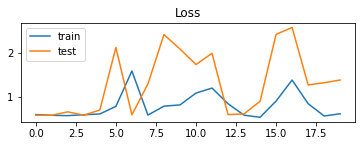

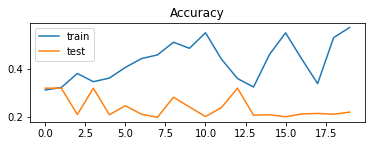

In [ ]:
pp.subplot(211)
pp.title('Loss')
pp.plot(hist.history['loss'], label='train')
pp.plot(hist.history['val_loss'], label='test')
pp.legend()
pp.show()

pp.subplot(211)
pp.title('Accuracy')
pp.plot(hist.history['acc'], label='train')
pp.plot(hist.history['val_acc'], label='test')
pp.legend()
pp.show()

## **Evaluation/Auto Prediction**

In [ ]:
developmentPrediction = model.evaluate(paddedDevData, devLabel, verbose=1)
print('Dev Prediction: ', np.round(developmentPrediction[1]*100, 2) ,' %')

30/30 [==============================] - 2s 82ms/step - loss: 1.3853 - acc: 0.2202
Dev Prediction:  22.02  %


## **Manual Prediction**

In [ ]:
yprime = model.predict(paddedDevData)
print('Predicted Label:\n\n',yprime) 
y = devLabel               
print('\nActual Label:\n\n',y)                

Predicted Label:

 [[0.0000000e+00 4.7221208e-01 0.0000000e+00 0.0000000e+00 0.0000000e+00
  3.5516173e-01]
 [0.0000000e+00 2.3744461e+10 3.8598129e+09 0.0000000e+00 0.0000000e+00
  0.0000000e+00]
 [3.7194887e-01 0.0000000e+00 1.4120395e-01 0.0000000e+00 1.4271007e-01
  1.0402941e-01]
 ...
 [4.0452990e-01 0.0000000e+00 1.5153331e-01 0.0000000e+00 1.6092436e-01
  8.3265856e-02]
 [8.6128697e-02 2.6546228e-01 3.4701500e-02 0.0000000e+00 0.0000000e+00
  2.6637861e-01]
 [1.4808762e-01 2.0333752e-01 5.7253614e-02 0.0000000e+00 5.8037117e-03
  2.3503494e-01]]

Actual Label:

 [[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


### Accuracy

In [ ]:
yprime = np.round(yprime.reshape(-1))
print('Predicted Output:\n', yprime)

y = np.round(y.reshape(-1))
print('actual Output:\n', y)

print('Accuracy Score: ',np.round(accuracy_score(y, yprime)*100 , 2), '%')

Predicted Output:
 [0. 1. 0. ... 0. 0. 1.]
actual Output:
 [0 0 0 ... 0 0 0]
Accuracy Score:  76.79 %


## **Confusion Matrix**

In [ ]:
expected = y
predicted = yprime
results = confusion_matrix(expected, predicted)
print(results)

[[4053  647]
 [ 662  278]]


## **F1 score**


In [ ]:
f1 = f1_score(y, yprime,average='micro')
print('F1 score: %f' % f1)

F1 score: 0.767908


## Export Output

decoding loss/acc data to string

In [ ]:
print(type(hist.history))
# print(hist.history)
# print(hist.history['acc'])
strLine = "Accuracy: "
for x in hist.history['acc']:
    t = np.format_float_positional(x)
    strLine += t+" "

strLine += "\n\nLoss: "
for x in hist.history['loss']:
    t = np.format_float_positional(x)
    strLine += t+" "

strLine += "\n\nValidation Accuracy: "
for x in hist.history['val_acc']:
    t = np.format_float_positional(x)
    strLine += t+" "

strLine += "\n\nValidation Loss: "
for x in hist.history['val_loss']:
    t = np.format_float_positional(x)
    strLine += t+" "
    
print(strLine)

<class 'dict'>
Accuracy: 0.3119148910045624 0.3219148814678192 0.37978723645210266 0.3459574580192566 0.3608510494232178 0.4048936069011688 0.4412766098976135 0.45638298988342285 0.5087233781814575 0.4838297963142395 0.5478723645210266 0.4387234151363373 0.3589361608028412 0.32404255867004395 0.45872339606285095 0.5474467873573303 0.4404255449771881 0.3380851149559021 0.5278723239898682 0.5697872042655945 

Loss: 0.6073768138885498 0.5921211242675781 0.5839787125587463 0.6042962074279785 0.6217123866081238 0.7927890419960022 1.588577151298523 0.5959903001785278 0.7983396649360657 0.825033962726593 1.0919889211654663 1.2044322490692139 0.8520404696464539 0.59526127576828 0.5466748476028442 0.9119354486465454 1.385184407234192 0.8534088730812073 0.5763729810714722 0.6260826587677002 

Validation Accuracy: 0.3191489279270172 0.3191489279270172 0.21063829958438873 0.3191489279270172 0.20957446098327637 0.2468085139989853 0.2117021232843399 0.19893616437911987 0.2819148898124695 0.241489365

one time use only 

In [ ]:
# !touch "/content/gdrive/My Drive/Colab Notebooks/output.txt" 

touch: cannot touch '/content/gdrive/My Drive/Colab Notebooks/output.txt': No such file or directory


writing output.txt file

In [ ]:
with open('/content/drive/MyDrive/Colab Notebooks/output.txt', 'w') as writefile:
    writefile.write(strLine)

# Exp 1

*importing required Libraries*

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import nltk
nltk.download('punkt')
from sklearn.metrics import accuracy_score
from tensorflow.keras.preprocessing.text import Tokenizer
from sklearn.feature_extraction.text import CountVectorizer
from nltk import word_tokenize
import warnings
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Embedding, Dense, LSTM, Bidirectional
from matplotlib import pyplot as pp
!pip install bnlp_toolkit

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


## Importing & Processing Train Data

In [ ]:
outputSet = []
inputSet = []
wordCount = lineCount = maxLen = left = right = 0

with open('/content/drive/MyDrive/Colab Notebooks/train.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        lineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                outputSet.append(temp)
                # if temp == "বিষণ্ণতা" or temp == "সুখী" or temp == "বিতৃষ্ণা" or temp == "বিস্ময়" or temp == "ভয়" or temp == "রাগ":
                    # outputSet.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        if cnt >= 18:
            right += 1
        else:
            left += 1 
        wordCount += cnt
        maxLen = max(maxLen, cnt)  
        str = str.strip(' ')
        inputSet.append(str)


print('Class/Label:',outputSet)
print('Train Data', inputSet)
print('Total Example/Lines: ',len(inputSet))
print('Total word: ',wordCount)

#Median Calculation 
avgWord = int(wordCount/lineCount)
print("\nMedian/Average Word Per Line: ", avgWord)
print("Max Words Per Line: ", maxLen)

print("\nwords per line more than average: ", right)
print("words per line less than average: ", left)

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
#Manually assigned the integer values for label
trainLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in outputSet]  
trainLabel = np.array(trainLabel)
print('Class/Label:',outputSet)
print('Class/Label (integer):', trainLabel)
print('Total Label/Output: ',len(trainLabel))

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
trainLabel = pd.get_dummies(trainLabel).values
trainLabel = np.array(trainLabel)
print('Shape of label tensor:', trainLabel.shape)
print(trainLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (4700, 6)
[[1 0 0 0 0 0]
 [1 0 0 0 0 0]
 [0 0 0 0 0 1]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


## Importing & Processing Development Data

In [ ]:
devInput = []
devOutput = []
devWordCount = devLineCount = devMaxLen = devLeft = devRight = 0

with open('/content/drive/MyDrive/Colab Notebooks/dev.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        devLineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                devOutput.append(temp)
            else:
                str += item+" "
                cnt += 1
        devWordCount += cnt
        devMaxLen = max(devMaxLen, cnt)  
        str = str.strip(' ')
        devInput.append(str)


print('Development Class/Label:',devOutput)
print('Development Data', devInput)
print('Total Development Example/Lines: ',len(devInput))
print('Total word: ',devWordCount)

#Median Calculation 
devAvgWord = int(devWordCount/devLineCount)
print("\nMedian/Average Word Per Line: ", devAvgWord)
print("Max Words Per Line: ", devMaxLen)

Development Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'র

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
#Manually assigned the integer values for label
devLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in devOutput]  
devLabel = np.array(devLabel)
print('Class/Label:',devOutput)
print('Class/Label (integer):', devLabel)
print('Total Label/Output: ',len(devLabel))

Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
devLabel = pd.get_dummies(devLabel).values
devLabel = np.array(devLabel)
print('Shape of label tensor:', devLabel.shape)
print(devLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (940, 6)
[[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


#### Testing `[less significant]`

In [ ]:
import nltk
s = inputSet[0]
words = nltk.word_tokenize(s)
# for w in words:
#     print(w)
print(words)
print(len(words))

['বরাবর', ',', 'মাননীয়', 'প্রধানমন্ত্রী', 'গণপ্রজাতন্ত্রী', 'বাংলাদেশ', 'সরকার।', 'মাননীয়', 'প্রধানমন্ত্রী', ',', 'আমি', 'আপনার', 'স্বপ্নের', 'ডিজিটাল', 'বাংলাদেশের', 'স্বপ্ন', 'বুকে', 'লালনকারী', 'একজন', 'সাধারণ', 'ছাত্র।', 'শত', 'সহস্র', 'আশা', 'এবং', 'দেশের', 'প্রতি', 'এক', 'অকৃত্তিম', 'ভালোবাসা', 'এবং', 'নিজেকে', 'দেশের', 'জন্য', 'যোগ্য', 'করে', 'গড়ে', 'তোলার', 'এক', 'তীব্র', 'আকাঙ্ক্ষা', 'নিয়ে', 'ভর্তি', 'হয়েছিলাম', 'আপনার', 'নিজ', 'হাতে', 'প্রতিষ্ঠিত', 'দেশের', 'অন্যতম', 'বিশ্ববিদ্যালয়', 'যশোর', 'বিজ্ঞান', 'ও', 'প্রযুক্তি', 'বিশ্ববিদ্যালয়ে।', 'একটি', 'ডিজিটাল', 'বাংলাদেশ', 'গড়তে', 'এ', 'ধরণের', 'একটি', 'প্রযুক্তি', 'বিশ্ববিদ্যালয়', 'প্রতিষ্ঠা', 'করা', 'নিঃসন্দেহে', 'আপনার', 'দেশ', 'পরিচালনার', 'একটি', 'বিচক্ষণতার', 'পরিচয়', 'বহন', 'করে।', 'আপনি', 'যশোর', 'বাসির', 'স্বপ্নের', 'এই', 'প্রতিষ্ঠানে', 'শত', 'শত', 'কোটি', 'টাকা', 'বিনিয়োগ', 'করেছেন', 'দুহাত', 'উজাড়', 'করে।', 'কিন্তু', 'অত্যন্ত', 'দুঃখের', 'সাথে', 'সেই', 'বিশ্ববিদ্যালয়', 'জীবনের', 'সূচনালগ্ন', 'থেকে', 'অনুভব

## Tokenization for Training

In [ ]:
# tokenization 
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(inputSet)

# converting words into sequences

print('Raw input: ',inputSet)
print('Unique words/tokens: ',tokenizer.word_index)

Raw input:  ['বরাবর, মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার। মাননীয় প্রধানমন্ত্রী, আমি আপনার স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন সাধারণ ছাত্র। শত সহস্র আশা এবং দেশের প্রতি এক অকৃত্তিম ভালোবাসা এবং নিজেকে দেশের জন্য যোগ্য করে গড়ে তোলার এক তীব্র আকাঙ্ক্ষা নিয়ে ভর্তি হয়েছিলাম আপনার নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান ও প্রযুক্তি বিশ্ববিদ্যালয়ে। একটি ডিজিটাল বাংলাদেশ গড়তে এ ধরণের একটি প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা করা নিঃসন্দেহে আপনার দেশ পরিচালনার একটি বিচক্ষণতার পরিচয় বহন করে। আপনি যশোর বাসির স্বপ্নের এই প্রতিষ্ঠানে শত শত কোটি টাকা বিনিয়োগ করেছেন দুহাত উজাড় করে। কিন্তু অত্যন্ত দুঃখের সাথে সেই বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন থেকে অনুভব করছি যে, অনেক পাওয়ার আনন্দে যখন শিক্ষার্থীদের মনপ্রান উজাড় করে পড়ালেখা করার কথা, তার বিপরীতে এই কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত করছে প্রাণ নাশের হুমকি, শ্লীলতাহানীর গ্লানি, আর ছাত্রত্ত বাতিল হওয়ার হুমকি নিয়ে। সম্মানিত শিক্ষকদের কে মারতে যাওয়া, গলা কেটে ফেলার হুমকি, প্রাণ নাশের হুম

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_train_ex = tokenizer.texts_to_sequences(inputSet)

print('Inputs after being converted: ',dense_train_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_train_ex))

Inputs after being converted:  [[4364, 1620, 399, 6716, 99, 1621, 1620, 399, 16, 7, 3225, 683, 138, 1090, 954, 6717, 89, 519, 6718, 955, 4365, 220, 49, 66, 228, 57, 6719, 956, 49, 357, 66, 11, 1091, 3, 4366, 6720, 57, 775, 6721, 358, 2638, 6722, 7, 657, 241, 4367, 66, 1622, 2639, 2640, 1023, 8, 2641, 6723, 208, 683, 99, 4368, 38, 1623, 208, 2641, 2639, 2146, 12, 2642, 7, 77, 6724, 208, 6725, 6726, 2643, 183, 23, 2640, 6727, 3225, 4, 3226, 955, 955, 266, 61, 6728, 374, 6729, 4369, 183, 53, 2147, 2148, 32, 102, 2639, 886, 6730, 30, 4370, 224, 10, 34, 6731, 1624, 163, 4371, 6732, 4369, 3, 6733, 62, 21, 29, 3227, 4, 6734, 4372, 2644, 6735, 157, 1832, 2645, 617, 6736, 6737, 6, 6738, 552, 3228, 617, 6739, 2149, 1625, 14, 3229, 4373, 553, 684, 4374, 617, 1832, 2645, 617, 6740, 12, 81, 335, 4375, 3230, 1620, 399, 492, 4372, 1625, 6741, 58, 446, 3, 39, 284, 89, 6742, 4376, 6743, 1833, 1625, 4375, 95, 1092, 1175, 3231, 17, 683, 138, 6744, 167, 1293, 6745, 1093, 58, 4377, 724, 3232, 163, 887, 284

## Tokenization for Dev

In [ ]:
# tokenization 
tokenizerDev = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizerDev.fit_on_texts(devInput)

# converting words into sequences
print('Raw input: ',devInput)
print('Unique words/tokens: ',tokenizerDev.word_index)

Raw input:  ['আল্লাও তো তার ঘর মসজিদকে রক্ষা করতে পারে না তাহলে কি আল্লা নেই??', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো??? আশ্চর্য হলাম, যে দেবতা নিজেকে নিজে রক্ষা করতে পারেনা সে অন্যদের কিভাবে রক্ষা করবে?', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস ও দেখলামনা। অতছ এখন.... হায়রে মানুষ???', 'আপনি কি প্রমান দিতে পারবেন আপনার টা সঠিক।', 'ইমরান ভাই অাপনি যদি মুসলমান হতেন তাহলে অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ,,,,,,,,,,,,,,,?', 'আমার মনে হয় প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ কে অস্থির করার জন্য কনো মুসলমান এটা করতে পারেনা', 'ইমরান বুঝে নিও।।। কোন এক দিন শুনতে পাব তোমারও গাড়ে মাথা নেই এই মুর্তি মত', 'এখন কোথায় হেফাজত ইসলাম এর সেই নেতা?যে বলে সংখালঘুরা নিরাপদে আছে?', 'আপনার সবাই গালি দেয় কেন?', 'এরা তো নিজেদেরকেই রক্ষা করতে পারে না। তবে তাদের সৃষ্টিকে কিভাবে রক্ষা করবে?', 'ভাই আপনি কি হিন্দু না মুসলমান', 'যখন ভারতের মুসলমানের উপর অত্যচার হয় তখন তো কেউ বলে না ।', 'এদেও এক দিন বিচার হবে ।হয় তো আমরা দেখতে পারবনা।।', 'আমার মনে হয় ইমরান কুমার শিল নিজেই এগুলো ভেঙেছে তা ছাড়া ছবি তুললেন কি ভ

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_dev_ex = tokenizerDev.texts_to_sequences(devInput)

print('Inputs after being converted: ',dense_dev_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_dev_ex))

Inputs after being converted:  [[1066, 15, 34, 630, 1067, 276, 25, 50, 4, 112, 3, 1068, 61], [182, 1069, 127, 631, 632, 633, 1070, 443, 23, 634, 163, 277, 276, 25, 236, 62, 635, 183, 276, 96], [89, 339, 1071, 51, 1072, 17, 1073, 1074, 78, 636, 12], [32, 3, 444, 210, 445, 29, 113, 1075], [10, 5, 340, 79, 97, 1076, 112, 340, 1077, 164, 16, 113, 1078, 1079], [47, 39, 26, 80, 105, 211, 637, 638, 70, 9, 639, 98, 11, 1080, 97, 22, 25, 236], [10, 640, 1081, 24, 67, 99, 641, 1082, 1083, 1084, 127, 61, 6, 341, 106], [78, 212, 446, 128, 30, 133, 642, 23, 43, 1085, 1086, 40], [29, 134, 278, 342, 45], [90, 15, 1087, 276, 25, 50, 37, 135, 44, 1088, 183, 276, 96], [5, 32, 3, 63, 4, 97], [114, 643, 1089, 136, 1090, 26, 115, 15, 116, 43, 4, 13], [1091, 67, 99, 16, 54, 1092, 15, 18, 343, 1093], [47, 39, 447, 10, 1094, 1095, 279, 143, 211, 91, 1096, 344, 1097, 3, 144], [21, 184, 280, 27, 6, 7, 46, 281, 51, 1098, 345, 145, 1099], [27, 31, 146, 8, 35, 644, 27, 31, 1100, 448, 1101, 1102, 213, 1103, 1104], 

### Test

In [ ]:
x = 0
for line in dense_dev_ex:
    for word in line:
        x = max(x,word)
print(x)

# print(max(dense_train_ex))

3576


## Vocabulary fetch 2

In [ ]:
# using countvectorizer to separate words from lines
vectorized = CountVectorizer(encoding='utf-8', tokenizer=word_tokenize)
vectorized.fit_transform(inputSet)

wordList = vectorized.get_feature_names()
uniqueWord = len(wordList)
print('Unique words: ',wordList)
print('Total Unique words: ',uniqueWord)

Unique words:  ['!', '#', '%', '&', "'", "''", "''আমি", "''ওঁরে", "'public'আমরা", "'re", "'s", "'অনুভুতি", "'আমি", "'উটপাখির", "'উত্তর", "'কয়েকজনি", "'খুমাতে", "'চলেন", "'জনগণ", "'দলীয়", "'দিনে", "'দিলেই", "'পজ", "'বদলে", "'মোশাদ", "'র", "'শাহবাগিরা", "'শুধুই", "'সংখ্যালঘু", "'সম্মুখে", "'সিকিউরিটি'দের।", "'সিস্টেমের", "'স্পর্শকাতর", "'স্পর্শের", "'হ্যাক", '(', ')', '***', '******', '*******', '***************************************', '***আমরা', '**এতে', '**এর', '**ধন্যবাদ', '*..', '*অস্রাব্য-বিশেষণ*দেরকে', '*তাসের', '*তাহলে', '*বাংলাদেশের', '+', '+icc', '+±+++++', '+স্বরাষ্ট্রমন্ত্রী', ',', ',।', ',।।।', ',অপরাধ', ',আইন', ',আজ', ',আপনাদের', ',আপনি', ',আমরা', ',আর', ',ইমরান', ',উনারা', ',উনি', ',এগুলুরে', ',এটা', ',এর', ',এরা', ',কি', ',কিন্তু', ',কিসের', ',ক্ষতি', ',ক্ষমাচেয়ে', ',গুটি', ',জনতার', ',টাকার', ',তা', ',তাই', ',তাতে', ',তার', ',তাহলে', ',তোর', ',দাবী', ',দিন', ',দেখে', ',দেশটা', ',ধন্যবাদ', ',না', ',পুচারে', ',বিচার', ',বুঝা', ',ভগবান', ',ভয়', ',যদি', ',লুটের', ',শালা', '

### Padding Train Data

In [ ]:
MAX_LENGTH_TRAIN = avgWord+10
print('Max Length: ',MAX_LENGTH_TRAIN)

paddedTrainData = pad_sequences(dense_train_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedTrainData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  27
[[ 2152  1443  2651 ...     8  2641  6776]
 [   44     1  1180 ...    20    93     1]
 [ 6784  4391  6785 ...     0     0     0]
 ...
 [ 4022  1033  2965 ...    34    45     5]
 [   31     9    72 ...   737   607   483]
 [17260  1860  1511 ...  2577  1044   204]]


### Padding Dev Data

In [ ]:
MAX_LENGTH_DEV = devAvgWord+10
print('Max Length: ',MAX_LENGTH_DEV)

paddedDevData = pad_sequences(dense_dev_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedDevData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  20
[[1066   15   34 ...    0    0    0]
 [ 182 1069  127 ...    0    0    0]
 [  89  339 1071 ...    0    0    0]
 ...
 [3571   23  208 ...    0    0    0]
 [  14 3573   11 ...    0    0    0]
 [3574 3575   10 ...    0    0    0]]


## Model 

### LSTM

run either LSTM or BiLSTM

In [ ]:
# Model Declaration
VOCAB_SIZE = uniqueWord+1
print(VOCAB_SIZE)
model = Sequential()

# Embedding Layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
model.add(embedding_layer)

# LSTM
hiddenLayer3 = LSTM(units=64, activation='relu', return_sequences=False)
model.add(hiddenLayer3)

# Output Layer
model.add(Dense(units=6, activation='softmax'))

model.compile(optimizer='Adam', loss='binary_crossentropy', metrics=['acc'])
print(model.summary())

17578
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 27, 10)            175780    
_________________________________________________________________
lstm (LSTM)                  (None, 64)                19200     
_________________________________________________________________
dense (Dense)                (None, 6)                 390       
Total params: 195,370
Trainable params: 195,370
Non-trainable params: 0
_________________________________________________________________
None


## Runnable 

In [ ]:
hist = model.fit(paddedTrainData, trainLabel, validation_data=(paddedDevData, devLabel), epochs=10, verbose=1)

Epoch 1/10
147/147 [==============================] - 3s 14ms/step - loss: 0.4726 - acc: 0.2796 - val_loss: 0.4240 - val_acc: 0.3191
Epoch 2/10
147/147 [==============================] - 2s 13ms/step - loss: 0.4012 - acc: 0.3383 - val_loss: 0.4655 - val_acc: 0.2468
Epoch 3/10
147/147 [==============================] - 2s 13ms/step - loss: 0.3453 - acc: 0.4702 - val_loss: 0.6953 - val_acc: 0.2245
Epoch 4/10
147/147 [==============================] - 2s 13ms/step - loss: 0.2988 - acc: 0.5330 - val_loss: 0.7466 - val_acc: 0.1894
Epoch 5/10
147/147 [==============================] - 2s 12ms/step - loss: 0.2679 - acc: 0.5928 - val_loss: 1.0298 - val_acc: 0.1840
Epoch 6/10
147/147 [==============================] - 2s 13ms/step - loss: 0.2436 - acc: 0.6421 - val_loss: 0.9236 - val_acc: 0.1777
Epoch 7/10
147/147 [==============================] - 2s 13ms/step - loss: 0.2211 - acc: 0.6913 - val_loss: 1.2025 - val_acc: 0.1851
Epoch 8/10
147/147 [==============================] - 2s 13ms/step - 

### Plotting Loss-Accuracy

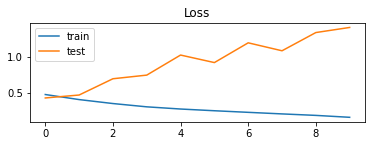

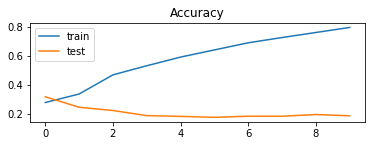

In [ ]:
pp.subplot(211)
pp.title('Loss')
pp.plot(hist.history['loss'], label='train')
pp.plot(hist.history['val_loss'], label='test')
pp.legend()
pp.show()

pp.subplot(211)
pp.title('Accuracy')
pp.plot(hist.history['acc'], label='train')
pp.plot(hist.history['val_acc'], label='test')
pp.legend()
pp.show()

## **Evaluation/Auto Prediction**

In [ ]:
developmentPrediction = model.evaluate(paddedDevData, devLabel, verbose=1)
print('Dev Prediction: ', np.round(developmentPrediction[1]*100, 2) ,' %')

30/30 [==============================] - 0s 4ms/step - loss: 1.4195 - acc: 0.1883
Dev Prediction:  18.83  %


## **Manual Prediction**

In [ ]:
yprime = model.predict(paddedDevData)
print('Predicted Label:\n\n',yprime) 
y = devLabel               
print('\nActual Label:\n\n',y)                

Predicted Label:

 [[5.8833302e-05 9.9993825e-01 1.7809630e-06 3.3775393e-07 7.7121911e-07
  4.6711180e-11]
 [1.4158188e-03 8.4041400e-05 1.9047539e-01 5.9065964e-02 2.6868071e-02
  7.2209072e-01]
 [9.9846220e-01 4.1322672e-04 2.8255690e-04 4.7240042e-04 8.1773222e-05
  2.8780356e-04]
 ...
 [9.9700987e-01 1.9390893e-03 3.8907258e-04 4.7710372e-04 9.9923527e-05
  8.4815641e-05]
 [6.3113160e-02 9.3641394e-01 2.7075163e-04 1.3154031e-04 7.0350055e-05
  2.9128142e-07]
 [1.2267620e-03 6.6202265e-05 7.4374989e-02 2.5651768e-02 1.0406123e-02
  8.8827413e-01]]

Actual Label:

 [[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


In [ ]:
yprime = np.round(yprime.reshape(-1))
print('Predicted Output:\n', yprime)

y = np.round(y.reshape(-1))
print('actual Output:\n', y)

print('Accuracy Score: ',np.round(accuracy_score(y, yprime)*100 , 2), '%')

Predicted Output:
 [0. 1. 0. ... 0. 0. 1.]
actual Output:
 [0 0 0 ... 0 0 0]
Accuracy Score:  73.48 %


# Exp 2

*importing required Libraries*

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import nltk
nltk.download('punkt')
from sklearn.metrics import accuracy_score
from tensorflow.keras.preprocessing.text import Tokenizer
from sklearn.feature_extraction.text import CountVectorizer
from nltk import word_tokenize
import warnings
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Embedding, Dense, LSTM, Bidirectional
from matplotlib import pyplot as pp
from sklearn.metrics import confusion_matrix
!pip install bnlp_toolkit

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')
# %cd /content/drive/MyDrive/Colab Notebooks

## Importing & Processing Train Data

In [ ]:
outputSet = []
inputSet = []
wordCount = lineCount = maxLen = left = right = 0

with open('/content/drive/MyDrive/Colab Notebooks/train.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        lineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                outputSet.append(temp)

                # if temp == "বিষণ্ণতা" or temp == "সুখী" or temp == "বিতৃষ্ণা" or temp == "বিস্ময়" or temp == "ভয়" or temp == "রাগ":
                    # outputSet.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        if cnt >= 18:
            right += 1
        else:
            left += 1 
        wordCount += cnt
        maxLen = max(maxLen, cnt)  
        str = str.strip(' ')
        inputSet.append(str)


print('Class/Label:',outputSet)
print('Train Data', inputSet)
print('Total Example/Lines: ',len(inputSet))
print('Total word: ',wordCount)

#Median Calculation 
avgWord = int(wordCount/lineCount)
print("\nMedian/Average Word Per Line: ", avgWord)
print("Max Words Per Line: ", maxLen)

print("\nwords per line more than average: ", right)
print("words per line less than average: ", left)

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
trainLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in outputSet]  
trainLabel = np.array(trainLabel)
print('Class/Label:',outputSet)
print('Class/Label (integer):', trainLabel)
print('Total Label/Output: ',len(trainLabel))

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
trainLabel = pd.get_dummies(trainLabel).values
trainLabel = np.array(trainLabel)
print('Shape of label tensor:', trainLabel.shape)
print(trainLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (4700, 6)
[[1 0 0 0 0 0]
 [1 0 0 0 0 0]
 [0 0 0 0 0 1]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


## Importing & Processing Development Data

In [ ]:
devInput = []
devOutput = []
devWordCount = devLineCount = devMaxLen = devLeft = devRight = 0

with open('/content/drive/MyDrive/Colab Notebooks/dev.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        devLineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                devOutput.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        # if cnt >= 18:
        #     devRight += 1
        # else:
        #     devLeft += 1 
        devWordCount += cnt
        devMaxLen = max(devMaxLen, cnt)  
        str = str.strip(' ')
        devInput.append(str)


print('Development Class/Label:',devOutput)
print('Development Data', devInput)
print('Total Development Example/Lines: ',len(devInput))
print('Total word: ',devWordCount)

#Median Calculation 
devAvgWord = int(devWordCount/devLineCount)
print("\nMedian/Average Word Per Line: ", devAvgWord)
print("Max Words Per Line: ", devMaxLen)

# print("\nwords per line more than average: ", right)
# print("words per line less than average: ", left)

Development Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'র

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
devLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in devOutput]  
devLabel = np.array(devLabel)
print('Class/Label:',devOutput)
print('Class/Label (integer):', devLabel)
print('Total Label/Output: ',len(devLabel))

Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
devLabel = pd.get_dummies(devLabel).values
devLabel = np.array(devLabel)
print('Shape of label tensor:', devLabel.shape)
print(devLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (940, 6)
[[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


#### Testing 

In [ ]:
import nltk
s = inputSet[0]
words = nltk.word_tokenize(s)
print(words)
print(len(words))

## Tokenization for Training

In [ ]:
# tokenization 
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(inputSet)

# converting words into sequences

print('Raw input: ',inputSet)
print('Unique words/tokens: ',tokenizer.word_index)

Raw input:  ['বরাবর, মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার। মাননীয় প্রধানমন্ত্রী, আমি আপনার স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন সাধারণ ছাত্র। শত সহস্র আশা এবং দেশের প্রতি এক অকৃত্তিম ভালোবাসা এবং নিজেকে দেশের জন্য যোগ্য করে গড়ে তোলার এক তীব্র আকাঙ্ক্ষা নিয়ে ভর্তি হয়েছিলাম আপনার নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান ও প্রযুক্তি বিশ্ববিদ্যালয়ে। একটি ডিজিটাল বাংলাদেশ গড়তে এ ধরণের একটি প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা করা নিঃসন্দেহে আপনার দেশ পরিচালনার একটি বিচক্ষণতার পরিচয় বহন করে। আপনি যশোর বাসির স্বপ্নের এই প্রতিষ্ঠানে শত শত কোটি টাকা বিনিয়োগ করেছেন দুহাত উজাড় করে। কিন্তু অত্যন্ত দুঃখের সাথে সেই বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন থেকে অনুভব করছি যে, অনেক পাওয়ার আনন্দে যখন শিক্ষার্থীদের মনপ্রান উজাড় করে পড়ালেখা করার কথা, তার বিপরীতে এই কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত করছে প্রাণ নাশের হুমকি, শ্লীলতাহানীর গ্লানি, আর ছাত্রত্ত বাতিল হওয়ার হুমকি নিয়ে। সম্মানিত শিক্ষকদের কে মারতে যাওয়া, গলা কেটে ফেলার হুমকি, প্রাণ নাশের হুম

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_train_ex = tokenizer.texts_to_sequences(inputSet)

print('Inputs after being converted: ',dense_train_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_train_ex))

Inputs after being converted:  [[4364, 1620, 399, 6716, 99, 1621, 1620, 399, 16, 7, 3225, 683, 138, 1090, 954, 6717, 89, 519, 6718, 955, 4365, 220, 49, 66, 228, 57, 6719, 956, 49, 357, 66, 11, 1091, 3, 4366, 6720, 57, 775, 6721, 358, 2638, 6722, 7, 657, 241, 4367, 66, 1622, 2639, 2640, 1023, 8, 2641, 6723, 208, 683, 99, 4368, 38, 1623, 208, 2641, 2639, 2146, 12, 2642, 7, 77, 6724, 208, 6725, 6726, 2643, 183, 23, 2640, 6727, 3225, 4, 3226, 955, 955, 266, 61, 6728, 374, 6729, 4369, 183, 53, 2147, 2148, 32, 102, 2639, 886, 6730, 30, 4370, 224, 10, 34, 6731, 1624, 163, 4371, 6732, 4369, 3, 6733, 62, 21, 29, 3227, 4, 6734, 4372, 2644, 6735, 157, 1832, 2645, 617, 6736, 6737, 6, 6738, 552, 3228, 617, 6739, 2149, 1625, 14, 3229, 4373, 553, 684, 4374, 617, 1832, 2645, 617, 6740, 12, 81, 335, 4375, 3230, 1620, 399, 492, 4372, 1625, 6741, 58, 446, 3, 39, 284, 89, 6742, 4376, 6743, 1833, 1625, 4375, 95, 1092, 1175, 3231, 17, 683, 138, 6744, 167, 1293, 6745, 1093, 58, 4377, 724, 3232, 163, 887, 284

## Tokenization for Dev

In [ ]:
# tokenization 
tokenizerDev = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizerDev.fit_on_texts(devInput)

# converting words into sequences
print('Raw input: ',devInput)
print('Unique words/tokens: ',tokenizerDev.word_index)

Raw input:  ['আল্লাও তো তার ঘর মসজিদকে রক্ষা করতে পারে না তাহলে কি আল্লা নেই??', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো??? আশ্চর্য হলাম, যে দেবতা নিজেকে নিজে রক্ষা করতে পারেনা সে অন্যদের কিভাবে রক্ষা করবে?', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস ও দেখলামনা। অতছ এখন.... হায়রে মানুষ???', 'আপনি কি প্রমান দিতে পারবেন আপনার টা সঠিক।', 'ইমরান ভাই অাপনি যদি মুসলমান হতেন তাহলে অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ,,,,,,,,,,,,,,,?', 'আমার মনে হয় প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ কে অস্থির করার জন্য কনো মুসলমান এটা করতে পারেনা', 'ইমরান বুঝে নিও।।। কোন এক দিন শুনতে পাব তোমারও গাড়ে মাথা নেই এই মুর্তি মত', 'এখন কোথায় হেফাজত ইসলাম এর সেই নেতা?যে বলে সংখালঘুরা নিরাপদে আছে?', 'আপনার সবাই গালি দেয় কেন?', 'এরা তো নিজেদেরকেই রক্ষা করতে পারে না। তবে তাদের সৃষ্টিকে কিভাবে রক্ষা করবে?', 'ভাই আপনি কি হিন্দু না মুসলমান', 'যখন ভারতের মুসলমানের উপর অত্যচার হয় তখন তো কেউ বলে না ।', 'এদেও এক দিন বিচার হবে ।হয় তো আমরা দেখতে পারবনা।।', 'আমার মনে হয় ইমরান কুমার শিল নিজেই এগুলো ভেঙেছে তা ছাড়া ছবি তুললেন কি ভ

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_dev_ex = tokenizerDev.texts_to_sequences(devInput)

print('Inputs after being converted: ',dense_dev_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_dev_ex))

Inputs after being converted:  [[1066, 15, 34, 630, 1067, 276, 25, 50, 4, 112, 3, 1068, 61], [182, 1069, 127, 631, 632, 633, 1070, 443, 23, 634, 163, 277, 276, 25, 236, 62, 635, 183, 276, 96], [89, 339, 1071, 51, 1072, 17, 1073, 1074, 78, 636, 12], [32, 3, 444, 210, 445, 29, 113, 1075], [10, 5, 340, 79, 97, 1076, 112, 340, 1077, 164, 16, 113, 1078, 1079], [47, 39, 26, 80, 105, 211, 637, 638, 70, 9, 639, 98, 11, 1080, 97, 22, 25, 236], [10, 640, 1081, 24, 67, 99, 641, 1082, 1083, 1084, 127, 61, 6, 341, 106], [78, 212, 446, 128, 30, 133, 642, 23, 43, 1085, 1086, 40], [29, 134, 278, 342, 45], [90, 15, 1087, 276, 25, 50, 37, 135, 44, 1088, 183, 276, 96], [5, 32, 3, 63, 4, 97], [114, 643, 1089, 136, 1090, 26, 115, 15, 116, 43, 4, 13], [1091, 67, 99, 16, 54, 1092, 15, 18, 343, 1093], [47, 39, 447, 10, 1094, 1095, 279, 143, 211, 91, 1096, 344, 1097, 3, 144], [21, 184, 280, 27, 6, 7, 46, 281, 51, 1098, 345, 145, 1099], [27, 31, 146, 8, 35, 644, 27, 31, 1100, 448, 1101, 1102, 213, 1103, 1104], 

## Vocabulary fetch 1

In [ ]:
x = 0
for line in dense_train_ex:
    for word in line:
        x = max(x,word)
print(x)
uniqueWord = x

17261


### Padding Train Data

In [ ]:
MAX_LENGTH_TRAIN = avgWord+10
print('Max Length: ',MAX_LENGTH_TRAIN)

paddedTrainData = pad_sequences(dense_train_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedTrainData)

Max Length:  27
[[ 2152  1443  2651 ...     8  2641  6776]
 [   44     1  1180 ...    20    93     1]
 [ 6784  4391  6785 ...     0     0     0]
 ...
 [ 4022  1033  2965 ...    34    45     5]
 [   31     9    72 ...   737   607   483]
 [17260  1860  1511 ...  2577  1044   204]]


### Padding Dev Data

In [ ]:
MAX_LENGTH_DEV = devAvgWord+10
print('Max Length: ',MAX_LENGTH_DEV)

paddedDevData = pad_sequences(dense_dev_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedDevData)

Max Length:  20
[[1066   15   34 ...    0    0    0]
 [ 182 1069  127 ...    0    0    0]
 [  89  339 1071 ...    0    0    0]
 ...
 [3571   23  208 ...    0    0    0]
 [  14 3573   11 ...    0    0    0]
 [3574 3575   10 ...    0    0    0]]


## Model 

### LSTM

In [ ]:
# Model Declaration
VOCAB_SIZE = uniqueWord+1
print(VOCAB_SIZE)
model = Sequential()

# Embedding Layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
model.add(embedding_layer)

# LSTM
hiddenLayer1 = LSTM(units=256, activation='relu', return_sequences=True)
hiddenLayer2 = LSTM(units=128, activation='relu', return_sequences=True)
hiddenLayer3 = LSTM(units=64, activation='relu', return_sequences=False)
model.add(hiddenLayer1)
model.add(hiddenLayer2)
model.add(hiddenLayer3)
model.add(Dense(units=6, activation='softmax'))

model.compile(optimizer='Adam', loss='mse', metrics=['acc'])
print(model.summary())

17262
Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_8 (Embedding)      (None, 27, 10)            172620    
_________________________________________________________________
lstm_9 (LSTM)                (None, 27, 256)           273408    
_________________________________________________________________
lstm_10 (LSTM)               (None, 27, 128)           197120    
_________________________________________________________________
lstm_11 (LSTM)               (None, 64)                49408     
_________________________________________________________________
dense_8 (Dense)              (None, 6)                 390       
Total params: 692,946
Trainable params: 692,946
Non-trainable params: 0
_________________________________________________________________
None


## Engine

In [ ]:
hist = model.fit(paddedTrainData, trainLabel, validation_data=(paddedDevData, devLabel), epochs=20, verbose=1)

Epoch 1/20
147/147 [==============================] - 29s 178ms/step - loss: 0.1303 - acc: 0.3247 - val_loss: 0.1367 - val_acc: 0.2160
Epoch 2/20
147/147 [==============================] - 25s 171ms/step - loss: 0.1114 - acc: 0.4336 - val_loss: 0.1496 - val_acc: 0.1989
Epoch 3/20
147/147 [==============================] - 25s 172ms/step - loss: 0.0970 - acc: 0.5034 - val_loss: 0.1671 - val_acc: 0.2032
Epoch 4/20
147/147 [==============================] - 25s 172ms/step - loss: 0.0874 - acc: 0.5719 - val_loss: 0.1781 - val_acc: 0.2096
Epoch 5/20
147/147 [==============================] - 25s 173ms/step - loss: 0.0801 - acc: 0.6155 - val_loss: 0.1736 - val_acc: 0.2128
Epoch 6/20
147/147 [==============================] - 26s 175ms/step - loss: 0.0755 - acc: 0.6360 - val_loss: 0.1857 - val_acc: 0.1681
Epoch 7/20
147/147 [==============================] - 26s 174ms/step - loss: 0.0711 - acc: 0.6594 - val_loss: 0.1872 - val_acc: 0.1787
Epoch 8/20
147/147 [==============================] - 2

### Plotting Loss-Accuracy

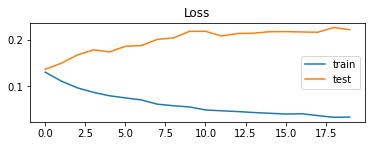

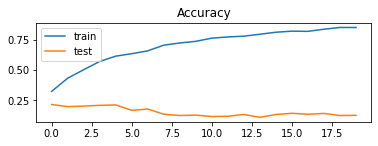

In [ ]:
pp.subplot(211)
pp.title('Loss')
pp.plot(hist.history['loss'], label='train')
pp.plot(hist.history['val_loss'], label='test')
pp.legend()
pp.show()

pp.subplot(211)
pp.title('Accuracy')
pp.plot(hist.history['acc'], label='train')
pp.plot(hist.history['val_acc'], label='test')
pp.legend()
pp.show()

## **Evaluation/Auto Prediction**

In [ ]:
developmentPrediction = model.evaluate(paddedDevData, devLabel, verbose=1)
print('Dev Prediction: ', np.round(developmentPrediction[1]*100, 2) ,' %')

30/30 [==============================] - 1s 47ms/step - loss: 0.2210 - acc: 0.1266
Dev Prediction:  12.66  %


## **Manual Prediction**

In [ ]:
yprime = model.predict(paddedDevData)
print('Predicted Label:\n\n',yprime) 
y = devLabel               
print('\nActual Label:\n\n',y)                

Predicted Label:

 [[1.4509141e-01 2.2582451e-03 3.6848918e-02 1.8341479e-01 6.3007408e-01
  2.3125145e-03]
 [9.9979228e-01 5.2218018e-21 7.4375661e-05 2.3134251e-13 8.0190802e-07
  1.3254282e-04]
 [2.4056967e-02 2.0428211e-05 1.7016903e-01 1.7588249e-03 8.2171289e-04
  8.0317307e-01]
 ...
 [5.4502428e-01 6.7636934e-03 1.5382002e-01 1.2378093e-01 1.4126927e-01
  2.9341839e-02]
 [1.7303072e-02 7.7181868e-02 2.4191402e-03 7.8834438e-01 1.1369680e-01
  1.0547135e-03]
 [1.5018395e-01 3.7008021e-03 5.6164414e-01 3.8536433e-02 2.7033104e-02
  2.1890156e-01]]

Actual Label:

 [[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


In [ ]:
yprime = np.round(yprime.reshape(-1))
print('Predicted Output:\n', yprime)

y = np.round(y.reshape(-1))
print('actual Output:\n', y)

print('Accuracy Score: ',np.round(accuracy_score(y, yprime)*100 , 2), '%')

Predicted Output:
 [0. 0. 0. ... 0. 0. 0.]
actual Output:
 [0 0 0 ... 0 0 0]
Accuracy Score:  73.83 %


## **Confusion Matrix**

In [ ]:
expected = y
predicted = yprime
results = confusion_matrix(expected, predicted)
print(results)

[[4068  632]
 [ 844   96]]


# Exp 3

*importing required Libraries*

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import nltk
nltk.download('punkt')
from sklearn.metrics import accuracy_score
from tensorflow.keras.preprocessing.text import Tokenizer
from sklearn.feature_extraction.text import CountVectorizer
from nltk import word_tokenize
import warnings
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Embedding, Dense, LSTM, Bidirectional
from matplotlib import pyplot as pp
from sklearn.metrics import confusion_matrix
!pip install bnlp_toolkit

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')
# %cd /content/drive/MyDrive/Colab Notebooks

## Importing & Processing Train Data

In [ ]:
outputSet = []
inputSet = []
wordCount = lineCount = maxLen = left = right = 0

with open('/content/drive/MyDrive/Colab Notebooks/train.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        lineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                outputSet.append(temp)

                # if temp == "বিষণ্ণতা" or temp == "সুখী" or temp == "বিতৃষ্ণা" or temp == "বিস্ময়" or temp == "ভয়" or temp == "রাগ":
                    # outputSet.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        if cnt >= 18:
            right += 1
        else:
            left += 1 
        wordCount += cnt
        maxLen = max(maxLen, cnt)  
        str = str.strip(' ')
        inputSet.append(str)


print('Class/Label:',outputSet)
print('Train Data', inputSet)
print('Total Example/Lines: ',len(inputSet))
print('Total word: ',wordCount)

#Median Calculation 
avgWord = int(wordCount/lineCount)
print("\nMedian/Average Word Per Line: ", avgWord)
print("Max Words Per Line: ", maxLen)

print("\nwords per line more than average: ", right)
print("words per line less than average: ", left)

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
trainLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in outputSet]  
trainLabel = np.array(trainLabel)
print('Class/Label:',outputSet)
print('Class/Label (integer):', trainLabel)
print('Total Label/Output: ',len(trainLabel))

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
trainLabel = pd.get_dummies(trainLabel).values
trainLabel = np.array(trainLabel)
print('Shape of label tensor:', trainLabel.shape)
print(trainLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (4700, 6)
[[1 0 0 0 0 0]
 [1 0 0 0 0 0]
 [0 0 0 0 0 1]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


## Importing & Processing Development Data

In [ ]:
devInput = []
devOutput = []
devWordCount = devLineCount = devMaxLen = devLeft = devRight = 0

with open('/content/drive/MyDrive/Colab Notebooks/dev.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        devLineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                devOutput.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        # if cnt >= 18:
        #     devRight += 1
        # else:
        #     devLeft += 1 
        devWordCount += cnt
        devMaxLen = max(devMaxLen, cnt)  
        str = str.strip(' ')
        devInput.append(str)


print('Development Class/Label:',devOutput)
print('Development Data', devInput)
print('Total Development Example/Lines: ',len(devInput))
print('Total word: ',devWordCount)

#Median Calculation 
devAvgWord = int(devWordCount/devLineCount)
print("\nMedian/Average Word Per Line: ", devAvgWord)
print("Max Words Per Line: ", devMaxLen)

# print("\nwords per line more than average: ", right)
# print("words per line less than average: ", left)

Development Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'র

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
devLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in devOutput]  
devLabel = np.array(devLabel)
print('Class/Label:',devOutput)
print('Class/Label (integer):', devLabel)
print('Total Label/Output: ',len(devLabel))

Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
devLabel = pd.get_dummies(devLabel).values
devLabel = np.array(devLabel)
print('Shape of label tensor:', devLabel.shape)
print(devLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (940, 6)
[[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


#### Testing 

In [ ]:
import nltk
s = inputSet[0]
words = nltk.word_tokenize(s)
# for w in words:
#     print(w)
print(words)
print(len(words))

## Tokenization for Training

In [ ]:
# tokenization 
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(inputSet)

# converting words into sequences

print('Raw input: ',inputSet)
print('Unique words/tokens: ',tokenizer.word_index)

Raw input:  ['বরাবর, মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার। মাননীয় প্রধানমন্ত্রী, আমি আপনার স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন সাধারণ ছাত্র। শত সহস্র আশা এবং দেশের প্রতি এক অকৃত্তিম ভালোবাসা এবং নিজেকে দেশের জন্য যোগ্য করে গড়ে তোলার এক তীব্র আকাঙ্ক্ষা নিয়ে ভর্তি হয়েছিলাম আপনার নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান ও প্রযুক্তি বিশ্ববিদ্যালয়ে। একটি ডিজিটাল বাংলাদেশ গড়তে এ ধরণের একটি প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা করা নিঃসন্দেহে আপনার দেশ পরিচালনার একটি বিচক্ষণতার পরিচয় বহন করে। আপনি যশোর বাসির স্বপ্নের এই প্রতিষ্ঠানে শত শত কোটি টাকা বিনিয়োগ করেছেন দুহাত উজাড় করে। কিন্তু অত্যন্ত দুঃখের সাথে সেই বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন থেকে অনুভব করছি যে, অনেক পাওয়ার আনন্দে যখন শিক্ষার্থীদের মনপ্রান উজাড় করে পড়ালেখা করার কথা, তার বিপরীতে এই কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত করছে প্রাণ নাশের হুমকি, শ্লীলতাহানীর গ্লানি, আর ছাত্রত্ত বাতিল হওয়ার হুমকি নিয়ে। সম্মানিত শিক্ষকদের কে মারতে যাওয়া, গলা কেটে ফেলার হুমকি, প্রাণ নাশের হুম

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_train_ex = tokenizer.texts_to_sequences(inputSet)

print('Inputs after being converted: ',dense_train_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_train_ex))

Inputs after being converted:  [[4364, 1620, 399, 6716, 99, 1621, 1620, 399, 16, 7, 3225, 683, 138, 1090, 954, 6717, 89, 519, 6718, 955, 4365, 220, 49, 66, 228, 57, 6719, 956, 49, 357, 66, 11, 1091, 3, 4366, 6720, 57, 775, 6721, 358, 2638, 6722, 7, 657, 241, 4367, 66, 1622, 2639, 2640, 1023, 8, 2641, 6723, 208, 683, 99, 4368, 38, 1623, 208, 2641, 2639, 2146, 12, 2642, 7, 77, 6724, 208, 6725, 6726, 2643, 183, 23, 2640, 6727, 3225, 4, 3226, 955, 955, 266, 61, 6728, 374, 6729, 4369, 183, 53, 2147, 2148, 32, 102, 2639, 886, 6730, 30, 4370, 224, 10, 34, 6731, 1624, 163, 4371, 6732, 4369, 3, 6733, 62, 21, 29, 3227, 4, 6734, 4372, 2644, 6735, 157, 1832, 2645, 617, 6736, 6737, 6, 6738, 552, 3228, 617, 6739, 2149, 1625, 14, 3229, 4373, 553, 684, 4374, 617, 1832, 2645, 617, 6740, 12, 81, 335, 4375, 3230, 1620, 399, 492, 4372, 1625, 6741, 58, 446, 3, 39, 284, 89, 6742, 4376, 6743, 1833, 1625, 4375, 95, 1092, 1175, 3231, 17, 683, 138, 6744, 167, 1293, 6745, 1093, 58, 4377, 724, 3232, 163, 887, 284

## Tokenization for Dev

In [ ]:
# tokenization 
tokenizerDev = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizerDev.fit_on_texts(devInput)

# converting words into sequences
print('Raw input: ',devInput)
print('Unique words/tokens: ',tokenizerDev.word_index)

Raw input:  ['আল্লাও তো তার ঘর মসজিদকে রক্ষা করতে পারে না তাহলে কি আল্লা নেই??', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো??? আশ্চর্য হলাম, যে দেবতা নিজেকে নিজে রক্ষা করতে পারেনা সে অন্যদের কিভাবে রক্ষা করবে?', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস ও দেখলামনা। অতছ এখন.... হায়রে মানুষ???', 'আপনি কি প্রমান দিতে পারবেন আপনার টা সঠিক।', 'ইমরান ভাই অাপনি যদি মুসলমান হতেন তাহলে অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ,,,,,,,,,,,,,,,?', 'আমার মনে হয় প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ কে অস্থির করার জন্য কনো মুসলমান এটা করতে পারেনা', 'ইমরান বুঝে নিও।।। কোন এক দিন শুনতে পাব তোমারও গাড়ে মাথা নেই এই মুর্তি মত', 'এখন কোথায় হেফাজত ইসলাম এর সেই নেতা?যে বলে সংখালঘুরা নিরাপদে আছে?', 'আপনার সবাই গালি দেয় কেন?', 'এরা তো নিজেদেরকেই রক্ষা করতে পারে না। তবে তাদের সৃষ্টিকে কিভাবে রক্ষা করবে?', 'ভাই আপনি কি হিন্দু না মুসলমান', 'যখন ভারতের মুসলমানের উপর অত্যচার হয় তখন তো কেউ বলে না ।', 'এদেও এক দিন বিচার হবে ।হয় তো আমরা দেখতে পারবনা।।', 'আমার মনে হয় ইমরান কুমার শিল নিজেই এগুলো ভেঙেছে তা ছাড়া ছবি তুললেন কি ভ

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_dev_ex = tokenizerDev.texts_to_sequences(devInput)

print('Inputs after being converted: ',dense_dev_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_dev_ex))

Inputs after being converted:  [[1066, 15, 34, 630, 1067, 276, 25, 50, 4, 112, 3, 1068, 61], [182, 1069, 127, 631, 632, 633, 1070, 443, 23, 634, 163, 277, 276, 25, 236, 62, 635, 183, 276, 96], [89, 339, 1071, 51, 1072, 17, 1073, 1074, 78, 636, 12], [32, 3, 444, 210, 445, 29, 113, 1075], [10, 5, 340, 79, 97, 1076, 112, 340, 1077, 164, 16, 113, 1078, 1079], [47, 39, 26, 80, 105, 211, 637, 638, 70, 9, 639, 98, 11, 1080, 97, 22, 25, 236], [10, 640, 1081, 24, 67, 99, 641, 1082, 1083, 1084, 127, 61, 6, 341, 106], [78, 212, 446, 128, 30, 133, 642, 23, 43, 1085, 1086, 40], [29, 134, 278, 342, 45], [90, 15, 1087, 276, 25, 50, 37, 135, 44, 1088, 183, 276, 96], [5, 32, 3, 63, 4, 97], [114, 643, 1089, 136, 1090, 26, 115, 15, 116, 43, 4, 13], [1091, 67, 99, 16, 54, 1092, 15, 18, 343, 1093], [47, 39, 447, 10, 1094, 1095, 279, 143, 211, 91, 1096, 344, 1097, 3, 144], [21, 184, 280, 27, 6, 7, 46, 281, 51, 1098, 345, 145, 1099], [27, 31, 146, 8, 35, 644, 27, 31, 1100, 448, 1101, 1102, 213, 1103, 1104], 

## Vocabulary fetch 2

In [ ]:
vectorized = CountVectorizer(encoding='utf-8', tokenizer=word_tokenize)
vectorized.fit_transform(inputSet)

wordList = vectorized.get_feature_names()
uniqueWord = len(wordList)
print('Unique words: ',wordList)
print('Total Unique words: ',uniqueWord)

Unique words:  ['!', '#', '%', '&', "'", "''", "''আমি", "''ওঁরে", "'public'আমরা", "'re", "'s", "'অনুভুতি", "'আমি", "'উটপাখির", "'উত্তর", "'কয়েকজনি", "'খুমাতে", "'চলেন", "'জনগণ", "'দলীয়", "'দিনে", "'দিলেই", "'পজ", "'বদলে", "'মোশাদ", "'র", "'শাহবাগিরা", "'শুধুই", "'সংখ্যালঘু", "'সম্মুখে", "'সিকিউরিটি'দের।", "'সিস্টেমের", "'স্পর্শকাতর", "'স্পর্শের", "'হ্যাক", '(', ')', '***', '******', '*******', '***************************************', '***আমরা', '**এতে', '**এর', '**ধন্যবাদ', '*..', '*অস্রাব্য-বিশেষণ*দেরকে', '*তাসের', '*তাহলে', '*বাংলাদেশের', '+', '+icc', '+±+++++', '+স্বরাষ্ট্রমন্ত্রী', ',', ',।', ',।।।', ',অপরাধ', ',আইন', ',আজ', ',আপনাদের', ',আপনি', ',আমরা', ',আর', ',ইমরান', ',উনারা', ',উনি', ',এগুলুরে', ',এটা', ',এর', ',এরা', ',কি', ',কিন্তু', ',কিসের', ',ক্ষতি', ',ক্ষমাচেয়ে', ',গুটি', ',জনতার', ',টাকার', ',তা', ',তাই', ',তাতে', ',তার', ',তাহলে', ',তোর', ',দাবী', ',দিন', ',দেখে', ',দেশটা', ',ধন্যবাদ', ',না', ',পুচারে', ',বিচার', ',বুঝা', ',ভগবান', ',ভয়', ',যদি', ',লুটের', ',শালা', '

### Padding Train Data

In [ ]:
MAX_LENGTH_TRAIN = avgWord+10
print('Max Length: ',MAX_LENGTH_TRAIN)

paddedTrainData = pad_sequences(dense_train_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedTrainData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  27
[[ 2152  1443  2651 ...     8  2641  6776]
 [   44     1  1180 ...    20    93     1]
 [ 6784  4391  6785 ...     0     0     0]
 ...
 [ 4022  1033  2965 ...    34    45     5]
 [   31     9    72 ...   737   607   483]
 [17260  1860  1511 ...  2577  1044   204]]


### Padding Dev Data

In [ ]:
MAX_LENGTH_DEV = devAvgWord+10
print('Max Length: ',MAX_LENGTH_DEV)

paddedDevData = pad_sequences(dense_dev_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedDevData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  20
[[1066   15   34 ...    0    0    0]
 [ 182 1069  127 ...    0    0    0]
 [  89  339 1071 ...    0    0    0]
 ...
 [3571   23  208 ...    0    0    0]
 [  14 3573   11 ...    0    0    0]
 [3574 3575   10 ...    0    0    0]]


## Model 

### LSTM

In [ ]:
# Model Declaration
VOCAB_SIZE = uniqueWord+1
print(VOCAB_SIZE)
model = Sequential()

# Embedding Layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
model.add(embedding_layer)

# LSTM
# forwardLayers = LSTM(units=128, input_shape=(np.shape(paddedTrainData)), activation='relu', return_sequences=True)
# hiddenLayer1 = LSTM(units=256, activation='relu', return_sequences=True)
# hiddenLayer2 = LSTM(units=128, activation='relu', return_sequences=True)
hiddenLayer3 = LSTM(units=64, activation='relu', return_sequences=False)
# model.add(hiddenLayer1)
# model.add(hiddenLayer2)
model.add(hiddenLayer3)

# model.add(Dense(units=64))
# model.add(Dense(units=32))
# model.add(Dense(units=16))
model.add(Dense(units=6, activation='softmax'))
# Output Layer
# model.compile(optimizer='adam', loss='mse', metrics=['acc'])
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['acc'])
# model.compile(optimizer='Adam', loss='mse', metrics=['acc'])
print(model.summary())

17262
Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_9 (Embedding)      (None, 27, 10)            172620    
_________________________________________________________________
lstm_12 (LSTM)               (None, 64)                19200     
_________________________________________________________________
dense_9 (Dense)              (None, 6)                 390       
Total params: 192,210
Trainable params: 192,210
Non-trainable params: 0
_________________________________________________________________
None


## Engine

In [ ]:
hist = model.fit(paddedTrainData, trainLabel, epochs=20, verbose=1)

Epoch 1/20
147/147 [==============================] - 5s 20ms/step - loss: 1.6600 - acc: 0.3183
Epoch 2/20
147/147 [==============================] - 3s 20ms/step - loss: 1.5261 - acc: 0.3555
Epoch 3/20
147/147 [==============================] - 3s 20ms/step - loss: 1.3389 - acc: 0.4062
Epoch 4/20
147/147 [==============================] - 3s 19ms/step - loss: 1.1466 - acc: 0.5000
Epoch 5/20
147/147 [==============================] - 3s 20ms/step - loss: 0.9877 - acc: 0.5636
Epoch 6/20
147/147 [==============================] - 3s 19ms/step - loss: 0.8485 - acc: 0.6306
Epoch 7/20
147/147 [==============================] - 3s 19ms/step - loss: 0.7404 - acc: 0.6836
Epoch 8/20
147/147 [==============================] - 3s 19ms/step - loss: 0.6444 - acc: 0.7362
Epoch 9/20
147/147 [==============================] - 3s 20ms/step - loss: 0.5708 - acc: 0.7730
Epoch 10/20
147/147 [==============================] - 3s 19ms/step - loss: 0.4773 - acc: 0.8166
Epoch 11/20
147/147 [==================

### Plotting Loss-Accuracy

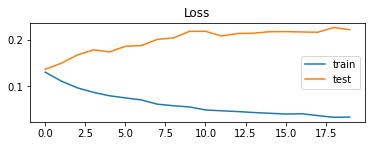

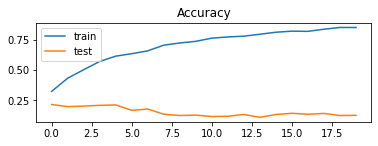

In [ ]:
pp.subplot(211)
pp.title('Loss')
pp.plot(hist.history['loss'], label='train')
pp.plot(hist.history['val_loss'], label='test')
pp.legend()
pp.show()

pp.subplot(211)
pp.title('Accuracy')
pp.plot(hist.history['acc'], label='train')
pp.plot(hist.history['val_acc'], label='test')
pp.legend()
pp.show()

## **Evaluation/Auto Prediction**

In [ ]:
developmentPrediction = model.evaluate(paddedDevData, devLabel, verbose=1)
print('Dev Prediction: ', np.round(developmentPrediction[1]*100, 2) ,' %')

30/30 [==============================] - 0s 5ms/step - loss: 12.4514 - acc: 0.1596
Dev Prediction:  15.96  %


## **Manual Prediction**

In [ ]:
yprime = model.predict(paddedDevData)
print('Predicted Label:\n\n',yprime) 
y = devLabel               
print('\nActual Label:\n\n',y)                

Predicted Label:

 [[5.00586274e-11 9.96691108e-01 2.16660192e-05 1.00693267e-08
  9.45667902e-20 3.28720827e-03]
 [2.23920960e-03 1.13563634e-04 5.55391647e-02 4.99316365e-01
  4.42782462e-01 9.22214622e-06]
 [7.44288508e-03 1.69318600e-03 4.23677338e-05 6.12794929e-06
  2.02805839e-09 9.90815401e-01]
 ...
 [8.60740021e-02 2.33130623e-03 1.06310232e-04 3.97327713e-05
  6.72133282e-08 9.11448538e-01]
 [2.04661774e-05 2.52080467e-02 2.00192680e-05 1.91241341e-07
  1.80427996e-14 9.74751234e-01]
 [1.50936142e-01 4.56390763e-03 2.70785938e-04 1.14726885e-04
  7.06426249e-07 8.44113708e-01]]

Actual Label:

 [[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


In [ ]:
yprime = np.round(yprime.reshape(-1))
print('Predicted Output:\n', yprime)

y = np.round(y.reshape(-1))
print('actual Output:\n', y)

print('Accuracy Score: ',np.round(accuracy_score(y, yprime)*100 , 2), '%')

Predicted Output:
 [0. 1. 0. ... 0. 0. 1.]
actual Output:
 [0 0 0 ... 0 0 0]
Accuracy Score:  72.16 %


## **Confusion Matrix**

In [ ]:
expected = y
predicted = yprime
results = confusion_matrix(expected, predicted)
print(results)

[[3922  778]
 [ 792  148]]


# Exp 4


*importing required Libraries*

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import nltk
nltk.download('punkt')
from sklearn.metrics import accuracy_score
from tensorflow.keras.preprocessing.text import Tokenizer
from sklearn.feature_extraction.text import CountVectorizer
from nltk import word_tokenize
import warnings
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Embedding, Dense, LSTM, Bidirectional
from matplotlib import pyplot as pp
from sklearn.metrics import confusion_matrix
!pip install bnlp_toolkit

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')
# %cd /content/drive/MyDrive/Colab Notebooks

## Importing & Processing Train Data

In [ ]:
outputSet = []
inputSet = []
wordCount = lineCount = maxLen = left = right = 0

with open('/content/drive/MyDrive/Colab Notebooks/train.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        lineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                outputSet.append(temp)

                # if temp == "বিষণ্ণতা" or temp == "সুখী" or temp == "বিতৃষ্ণা" or temp == "বিস্ময়" or temp == "ভয়" or temp == "রাগ":
                    # outputSet.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        if cnt >= 18:
            right += 1
        else:
            left += 1 
        wordCount += cnt
        maxLen = max(maxLen, cnt)  
        str = str.strip(' ')
        inputSet.append(str)


print('Class/Label:',outputSet)
print('Train Data', inputSet)
print('Total Example/Lines: ',len(inputSet))
print('Total word: ',wordCount)

#Median Calculation 
avgWord = int(wordCount/lineCount)
print("\nMedian/Average Word Per Line: ", avgWord)
print("Max Words Per Line: ", maxLen)

print("\nwords per line more than average: ", right)
print("words per line less than average: ", left)

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
trainLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in outputSet]  
trainLabel = np.array(trainLabel)
print('Class/Label:',outputSet)
print('Class/Label (integer):', trainLabel)
print('Total Label/Output: ',len(trainLabel))

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
trainLabel = pd.get_dummies(trainLabel).values
trainLabel = np.array(trainLabel)
print('Shape of label tensor:', trainLabel.shape)
print(trainLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (4700, 6)
[[1 0 0 0 0 0]
 [1 0 0 0 0 0]
 [0 0 0 0 0 1]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


## Importing & Processing Development Data

In [ ]:
devInput = []
devOutput = []
devWordCount = devLineCount = devMaxLen = devLeft = devRight = 0

with open('/content/drive/MyDrive/Colab Notebooks/dev.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        devLineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                devOutput.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        # if cnt >= 18:
        #     devRight += 1
        # else:
        #     devLeft += 1 
        devWordCount += cnt
        devMaxLen = max(devMaxLen, cnt)  
        str = str.strip(' ')
        devInput.append(str)


print('Development Class/Label:',devOutput)
print('Development Data', devInput)
print('Total Development Example/Lines: ',len(devInput))
print('Total word: ',devWordCount)

#Median Calculation 
devAvgWord = int(devWordCount/devLineCount)
print("\nMedian/Average Word Per Line: ", devAvgWord)
print("Max Words Per Line: ", devMaxLen)

# print("\nwords per line more than average: ", right)
# print("words per line less than average: ", left)

Development Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'র

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
devLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in devOutput]  
devLabel = np.array(devLabel)
print('Class/Label:',devOutput)
print('Class/Label (integer):', devLabel)
print('Total Label/Output: ',len(devLabel))

Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
devLabel = pd.get_dummies(devLabel).values
devLabel = np.array(devLabel)
print('Shape of label tensor:', devLabel.shape)
print(devLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (940, 6)
[[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


#### Testing 

In [ ]:
import nltk
s = inputSet[0]
words = nltk.word_tokenize(s)
# for w in words:
#     print(w)
print(words)
print(len(words))

## Tokenization for Training

In [ ]:
# tokenization 
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(inputSet)

# converting words into sequences

print('Raw input: ',inputSet)
print('Unique words/tokens: ',tokenizer.word_index)

Raw input:  ['বরাবর, মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার। মাননীয় প্রধানমন্ত্রী, আমি আপনার স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন সাধারণ ছাত্র। শত সহস্র আশা এবং দেশের প্রতি এক অকৃত্তিম ভালোবাসা এবং নিজেকে দেশের জন্য যোগ্য করে গড়ে তোলার এক তীব্র আকাঙ্ক্ষা নিয়ে ভর্তি হয়েছিলাম আপনার নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান ও প্রযুক্তি বিশ্ববিদ্যালয়ে। একটি ডিজিটাল বাংলাদেশ গড়তে এ ধরণের একটি প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা করা নিঃসন্দেহে আপনার দেশ পরিচালনার একটি বিচক্ষণতার পরিচয় বহন করে। আপনি যশোর বাসির স্বপ্নের এই প্রতিষ্ঠানে শত শত কোটি টাকা বিনিয়োগ করেছেন দুহাত উজাড় করে। কিন্তু অত্যন্ত দুঃখের সাথে সেই বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন থেকে অনুভব করছি যে, অনেক পাওয়ার আনন্দে যখন শিক্ষার্থীদের মনপ্রান উজাড় করে পড়ালেখা করার কথা, তার বিপরীতে এই কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত করছে প্রাণ নাশের হুমকি, শ্লীলতাহানীর গ্লানি, আর ছাত্রত্ত বাতিল হওয়ার হুমকি নিয়ে। সম্মানিত শিক্ষকদের কে মারতে যাওয়া, গলা কেটে ফেলার হুমকি, প্রাণ নাশের হুম

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_train_ex = tokenizer.texts_to_sequences(inputSet)

print('Inputs after being converted: ',dense_train_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_train_ex))

Inputs after being converted:  [[4364, 1620, 399, 6716, 99, 1621, 1620, 399, 16, 7, 3225, 683, 138, 1090, 954, 6717, 89, 519, 6718, 955, 4365, 220, 49, 66, 228, 57, 6719, 956, 49, 357, 66, 11, 1091, 3, 4366, 6720, 57, 775, 6721, 358, 2638, 6722, 7, 657, 241, 4367, 66, 1622, 2639, 2640, 1023, 8, 2641, 6723, 208, 683, 99, 4368, 38, 1623, 208, 2641, 2639, 2146, 12, 2642, 7, 77, 6724, 208, 6725, 6726, 2643, 183, 23, 2640, 6727, 3225, 4, 3226, 955, 955, 266, 61, 6728, 374, 6729, 4369, 183, 53, 2147, 2148, 32, 102, 2639, 886, 6730, 30, 4370, 224, 10, 34, 6731, 1624, 163, 4371, 6732, 4369, 3, 6733, 62, 21, 29, 3227, 4, 6734, 4372, 2644, 6735, 157, 1832, 2645, 617, 6736, 6737, 6, 6738, 552, 3228, 617, 6739, 2149, 1625, 14, 3229, 4373, 553, 684, 4374, 617, 1832, 2645, 617, 6740, 12, 81, 335, 4375, 3230, 1620, 399, 492, 4372, 1625, 6741, 58, 446, 3, 39, 284, 89, 6742, 4376, 6743, 1833, 1625, 4375, 95, 1092, 1175, 3231, 17, 683, 138, 6744, 167, 1293, 6745, 1093, 58, 4377, 724, 3232, 163, 887, 284

## Tokenization for Dev

In [ ]:
# tokenization 
tokenizerDev = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizerDev.fit_on_texts(devInput)

# converting words into sequences
print('Raw input: ',devInput)
print('Unique words/tokens: ',tokenizerDev.word_index)

Raw input:  ['আল্লাও তো তার ঘর মসজিদকে রক্ষা করতে পারে না তাহলে কি আল্লা নেই??', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো??? আশ্চর্য হলাম, যে দেবতা নিজেকে নিজে রক্ষা করতে পারেনা সে অন্যদের কিভাবে রক্ষা করবে?', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস ও দেখলামনা। অতছ এখন.... হায়রে মানুষ???', 'আপনি কি প্রমান দিতে পারবেন আপনার টা সঠিক।', 'ইমরান ভাই অাপনি যদি মুসলমান হতেন তাহলে অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ,,,,,,,,,,,,,,,?', 'আমার মনে হয় প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ কে অস্থির করার জন্য কনো মুসলমান এটা করতে পারেনা', 'ইমরান বুঝে নিও।।। কোন এক দিন শুনতে পাব তোমারও গাড়ে মাথা নেই এই মুর্তি মত', 'এখন কোথায় হেফাজত ইসলাম এর সেই নেতা?যে বলে সংখালঘুরা নিরাপদে আছে?', 'আপনার সবাই গালি দেয় কেন?', 'এরা তো নিজেদেরকেই রক্ষা করতে পারে না। তবে তাদের সৃষ্টিকে কিভাবে রক্ষা করবে?', 'ভাই আপনি কি হিন্দু না মুসলমান', 'যখন ভারতের মুসলমানের উপর অত্যচার হয় তখন তো কেউ বলে না ।', 'এদেও এক দিন বিচার হবে ।হয় তো আমরা দেখতে পারবনা।।', 'আমার মনে হয় ইমরান কুমার শিল নিজেই এগুলো ভেঙেছে তা ছাড়া ছবি তুললেন কি ভ

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_dev_ex = tokenizerDev.texts_to_sequences(devInput)

print('Inputs after being converted: ',dense_dev_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_dev_ex))

Inputs after being converted:  [[1066, 15, 34, 630, 1067, 276, 25, 50, 4, 112, 3, 1068, 61], [182, 1069, 127, 631, 632, 633, 1070, 443, 23, 634, 163, 277, 276, 25, 236, 62, 635, 183, 276, 96], [89, 339, 1071, 51, 1072, 17, 1073, 1074, 78, 636, 12], [32, 3, 444, 210, 445, 29, 113, 1075], [10, 5, 340, 79, 97, 1076, 112, 340, 1077, 164, 16, 113, 1078, 1079], [47, 39, 26, 80, 105, 211, 637, 638, 70, 9, 639, 98, 11, 1080, 97, 22, 25, 236], [10, 640, 1081, 24, 67, 99, 641, 1082, 1083, 1084, 127, 61, 6, 341, 106], [78, 212, 446, 128, 30, 133, 642, 23, 43, 1085, 1086, 40], [29, 134, 278, 342, 45], [90, 15, 1087, 276, 25, 50, 37, 135, 44, 1088, 183, 276, 96], [5, 32, 3, 63, 4, 97], [114, 643, 1089, 136, 1090, 26, 115, 15, 116, 43, 4, 13], [1091, 67, 99, 16, 54, 1092, 15, 18, 343, 1093], [47, 39, 447, 10, 1094, 1095, 279, 143, 211, 91, 1096, 344, 1097, 3, 144], [21, 184, 280, 27, 6, 7, 46, 281, 51, 1098, 345, 145, 1099], [27, 31, 146, 8, 35, 644, 27, 31, 1100, 448, 1101, 1102, 213, 1103, 1104], 

### Test

In [ ]:
x = 0
for line in dense_dev_ex:
    for word in line:
        x = max(x,word)
print(x)

# print(max(dense_train_ex))

3576


## Vocabulary fetch 1

In [ ]:
x = 0
for line in dense_train_ex:
    for word in line:
        x = max(x,word)
print(x)
uniqueWord = x
# print(max(dense_train_ex))

17261


### Padding Train Data

In [ ]:
MAX_LENGTH_TRAIN = avgWord+10
print('Max Length: ',MAX_LENGTH_TRAIN)

paddedTrainData = pad_sequences(dense_train_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedTrainData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  27
[[ 2152  1443  2651 ...     8  2641  6776]
 [   44     1  1180 ...    20    93     1]
 [ 6784  4391  6785 ...     0     0     0]
 ...
 [ 4022  1033  2965 ...    34    45     5]
 [   31     9    72 ...   737   607   483]
 [17260  1860  1511 ...  2577  1044   204]]


### Padding Dev Data

In [ ]:
MAX_LENGTH_DEV = devAvgWord+10
print('Max Length: ',MAX_LENGTH_DEV)

paddedDevData = pad_sequences(dense_dev_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedDevData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  20
[[1066   15   34 ...    0    0    0]
 [ 182 1069  127 ...    0    0    0]
 [  89  339 1071 ...    0    0    0]
 ...
 [3571   23  208 ...    0    0    0]
 [  14 3573   11 ...    0    0    0]
 [3574 3575   10 ...    0    0    0]]


In [ ]:
devAvgWord


10

## Model 

### Bidirectional LSTM

In [ ]:
# Model Declaration
VOCAB_SIZE = uniqueWord+1

model = Sequential()

# Embedding Layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
model.add(embedding_layer)

# Bidirectional LSTM
# forwardLayers = LSTM(units=128, input_shape=(np.shape(paddedTrainData)), activation='relu', return_sequences=False)
forwardLayers = LSTM(units=128, return_sequences=False)
backwardLayers = LSTM(units=128, return_sequences=False, go_backwards=True)
model.add(Bidirectional(layer=forwardLayers,  backward_layer=backwardLayers))

# Output Layer
model.add(Dense(units=6, activation='softmax'))
# model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc'])
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['acc'])
# model.compile(optimizer='adam', loss='mse', metrics=['acc'])
print(model.summary())

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_10 (Embedding)     (None, 27, 10)            172620    
_________________________________________________________________
bidirectional_1 (Bidirection (None, 256)               142336    
_________________________________________________________________
dense_10 (Dense)             (None, 6)                 1542      
Total params: 316,498
Trainable params: 316,498
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
print(np.shape(paddedTrainData))
print(np.shape(trainLabel))
print(type(paddedTrainData))
print(type(trainLabel))

(4700, 27)
(4700, 6)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


## Engine

In [ ]:
hist = model.fit(paddedTrainData, trainLabel, epochs=10, verbose=1)

Epoch 1/10
147/147 [==============================] - 11s 51ms/step - loss: 1.6364 - acc: 0.3300
Epoch 2/10
147/147 [==============================] - 7s 51ms/step - loss: 1.3808 - acc: 0.4385
Epoch 3/10
147/147 [==============================] - 7s 50ms/step - loss: 1.1383 - acc: 0.5355
Epoch 4/10
147/147 [==============================] - 7s 50ms/step - loss: 0.9001 - acc: 0.6317
Epoch 5/10
147/147 [==============================] - 7s 51ms/step - loss: 0.6935 - acc: 0.7232
Epoch 6/10
147/147 [==============================] - 7s 50ms/step - loss: 0.5302 - acc: 0.7930
Epoch 7/10
147/147 [==============================] - 8s 51ms/step - loss: 0.3775 - acc: 0.8719
Epoch 8/10
147/147 [==============================] - 7s 51ms/step - loss: 0.2402 - acc: 0.9243
Epoch 9/10
147/147 [==============================] - 7s 51ms/step - loss: 0.1669 - acc: 0.9491
Epoch 10/10
147/147 [==============================] - 7s 50ms/step - loss: 0.1184 - acc: 0.9681


### Plotting Loss-Accuracy

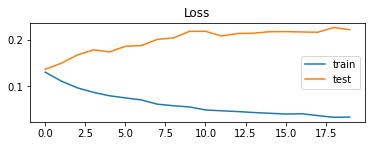

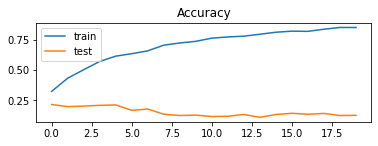

In [ ]:
pp.subplot(211)
pp.title('Loss')
pp.plot(hist.history['loss'], label='train')
pp.plot(hist.history['val_loss'], label='test')
pp.legend()
pp.show()

pp.subplot(211)
pp.title('Accuracy')
pp.plot(hist.history['acc'], label='train')
pp.plot(hist.history['val_acc'], label='test')
pp.legend()
pp.show()

## **Evaluation/Auto Prediction**

In [ ]:
developmentPrediction = model.evaluate(paddedDevData, devLabel, verbose=1)
print('Dev Prediction: ', np.round(developmentPrediction[1]*100, 2) ,' %')

30/30 [==============================] - 1s 13ms/step - loss: 4.5065 - acc: 0.1936
Dev Prediction:  19.36  %


## **Manual Prediction**

In [ ]:
yprime = model.predict(paddedDevData)
print('Predicted Label:\n\n',yprime) 
y = devLabel               
print('\nActual Label:\n\n',y)                

Predicted Label:

 [[9.9633729e-01 1.3484029e-03 2.4357068e-04 3.2216878e-05 2.6644455e-04
  1.7721058e-03]
 [1.2167347e-02 1.2338479e-05 2.1562979e-01 2.9641293e-02 7.4236482e-01
  1.8439320e-04]
 [6.7247790e-01 4.3034642e-03 1.0902012e-01 1.1947958e-02 1.3970810e-02
  1.8827972e-01]
 ...
 [3.7707746e-01 3.0495817e-04 2.3939027e-01 2.9753238e-02 2.4498515e-03
  3.5102421e-01]
 [7.0847154e-01 1.5977113e-01 1.5312127e-02 6.2013124e-03 8.2310019e-03
  1.0201292e-01]
 [2.7674276e-04 5.5998498e-06 1.5055287e-02 3.8287470e-03 4.4590070e-06
  9.8082918e-01]]

Actual Label:

 [[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


In [ ]:
yprime = np.round(yprime.reshape(-1))
print('Predicted Output:\n', yprime)

y = np.round(y.reshape(-1))
print('actual Output:\n', y)

print('Accuracy Score: ',np.round(accuracy_score(y, yprime)*100 , 2), '%')

Predicted Output:
 [1. 0. 0. ... 0. 0. 1.]
actual Output:
 [0 0 0 ... 0 0 0]
Accuracy Score:  75.23 %


## **Confusion Matrix**

In [ ]:
expected = y
predicted = yprime
results = confusion_matrix(expected, predicted)
print(results)

[[4083  617]
 [ 780  160]]


# Exp 5


*importing required Libraries*

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import nltk
nltk.download('punkt')
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score
from tensorflow.keras.preprocessing.text import Tokenizer
from sklearn.feature_extraction.text import CountVectorizer
from nltk import word_tokenize
import warnings
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Embedding, Dense, LSTM, Bidirectional
from matplotlib import pyplot
!pip install bnlp_toolkit

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')
# %cd /content/drive/MyDrive/Colab Notebooks

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


## Importing & Processing Train Data

In [ ]:
outputSet = []
inputSet = []
wordCount = lineCount = maxLen = left = right = 0

with open('/content/drive/MyDrive/Colab Notebooks/train.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        lineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                outputSet.append(temp)

                # if temp == "বিষণ্ণতা" or temp == "সুখী" or temp == "বিতৃষ্ণা" or temp == "বিস্ময়" or temp == "ভয়" or temp == "রাগ":
                    # outputSet.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        if cnt >= 18:
            right += 1
        else:
            left += 1 
        wordCount += cnt
        maxLen = max(maxLen, cnt)  
        str = str.strip(' ')
        inputSet.append(str)


print('Class/Label:',outputSet)
print('Train Data', inputSet)
print('Total Example/Lines: ',len(inputSet))
print('Total word: ',wordCount)

#Median Calculation 
avgWord = int(wordCount/lineCount)
print("\nMedian/Average Word Per Line: ", avgWord)
print("Max Words Per Line: ", maxLen)

print("\nwords per line more than average: ", right)
print("words per line less than average: ", left)

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
trainLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in outputSet]  
trainLabel = np.array(trainLabel)
print('Class/Label:',outputSet)
print('Class/Label (integer):', trainLabel)
print('Total Label/Output: ',len(trainLabel))

Class/Label: ['বিষণ্ণতা', 'বিষণ্ণতা', 'রাগ', 'সুখী', 'রাগ', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'বিষণ্ণতা', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'বিস্ময়', 'রাগ', 'ভয়', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'সুখী', 'রাগ', 'ভয়', 'বিতৃষ্ণা', 'ভয়', 'বিষণ্ণতা', 'বিষণ্ণতা', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'রাগ', 'সুখী', 'বিষণ্ণতা', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিস্ময়', 'সুখী', 'বিস্ময়', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'সুখী', 'বিতৃষ্ণা', 'সুখী', 'সুখী', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'রাগ', 'ভয়', 'বিস্ময়', 'সুখী', 'সুখী', 'ভয়', 'রাগ', 'সুখী', 'বিস্ময়', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'রাগ', 'রাগ', 'বিষণ্ণতা', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'বিতৃষ্ণা', 'বিতৃষ্ণা', 'বিস্ময়', 'রাগ', 'রাগ', 'বিতৃষ্ণা', 'ভয়', 'বিতৃষ্ণা', 'বিস্ময়', 'বিতৃষ্ণা', 'রাগ', 'বিতৃষ্ণা', 'রাগ', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিষণ্ণতা', 'বিতৃষ্ণা', 'বিষণ্ণতা', 'সুখী', 'সুখী', 'বিস্ময়', 'রাগ', 'ভয়', 'বিষণ্ণতা', '

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
trainLabel = pd.get_dummies(trainLabel).values
trainLabel = np.array(trainLabel)
print('Shape of label tensor:', trainLabel.shape)
print(trainLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (4700, 6)
[[1 0 0 0 0 0]
 [1 0 0 0 0 0]
 [0 0 0 0 0 1]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


## Importing & Processing Development Data

In [ ]:
devInput = []
devOutput = []
devWordCount = devLineCount = devMaxLen = devLeft = devRight = 0

with open('/content/drive/MyDrive/Colab Notebooks/dev.txt', 'r') as f:
    for line in f.readlines():
        flag = True 
        devLineCount += 1
        cnt = 0
        items = line.split()
        str = ""
        for item in items:
            if item.startswith('"') and item.endswith('"') and flag:
                flag = False
                temp = item.strip('""')
                devOutput.append(temp)
            else:
                str += item+" "
                cnt += 1
        # print(str)
        # if cnt >= 18:
        #     devRight += 1
        # else:
        #     devLeft += 1 
        devWordCount += cnt
        devMaxLen = max(devMaxLen, cnt)  
        str = str.strip(' ')
        devInput.append(str)


print('Development Class/Label:',devOutput)
print('Development Data', devInput)
print('Total Development Example/Lines: ',len(devInput))
print('Total word: ',devWordCount)

#Median Calculation 
devAvgWord = int(devWordCount/devLineCount)
print("\nMedian/Average Word Per Line: ", devAvgWord)
print("Max Words Per Line: ", devMaxLen)

# print("\nwords per line more than average: ", right)
# print("words per line less than average: ", left)

Development Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'র

### Converting labels to numbers


*conversion of the class labels into integers*

In [ ]:
devLabel = [1 if i=='বিষণ্ণতা' else 2 if i=='সুখী' else 3 if i=='বিতৃষ্ণা' else 4 if i=='বিস্ময়' else 5 if i=='ভয়' else 6 if i=='রাগ' else i for i in devOutput]  
devLabel = np.array(devLabel)
print('Class/Label:',devOutput)
print('Class/Label (integer):', devLabel)
print('Total Label/Output: ',len(devLabel))

Class/Label: ['বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'ভয়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'ভয়', 'বিস্ময়', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'ভয়', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'ভয়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময়', 'বিস্ময়', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'রাগ', 'বিস্ময

*2D conversion*

In [ ]:
# convert single dimension label into two dimensional matrix where occurrence shown as zeros and ones 
devLabel = pd.get_dummies(devLabel).values
devLabel = np.array(devLabel)
print('Shape of label tensor:', devLabel.shape)
print(devLabel)
# for iter in trainLabel.tolist():
    # print(iter)

Shape of label tensor: (940, 6)
[[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


#### Testing 

In [ ]:
import nltk
s = inputSet[0]
words = nltk.word_tokenize(s)
# for w in words:
#     print(w)
print(words)
print(len(words))

['বরাবর', ',', 'মাননীয়', 'প্রধানমন্ত্রী', 'গণপ্রজাতন্ত্রী', 'বাংলাদেশ', 'সরকার।', 'মাননীয়', 'প্রধানমন্ত্রী', ',', 'আমি', 'আপনার', 'স্বপ্নের', 'ডিজিটাল', 'বাংলাদেশের', 'স্বপ্ন', 'বুকে', 'লালনকারী', 'একজন', 'সাধারণ', 'ছাত্র।', 'শত', 'সহস্র', 'আশা', 'এবং', 'দেশের', 'প্রতি', 'এক', 'অকৃত্তিম', 'ভালোবাসা', 'এবং', 'নিজেকে', 'দেশের', 'জন্য', 'যোগ্য', 'করে', 'গড়ে', 'তোলার', 'এক', 'তীব্র', 'আকাঙ্ক্ষা', 'নিয়ে', 'ভর্তি', 'হয়েছিলাম', 'আপনার', 'নিজ', 'হাতে', 'প্রতিষ্ঠিত', 'দেশের', 'অন্যতম', 'বিশ্ববিদ্যালয়', 'যশোর', 'বিজ্ঞান', 'ও', 'প্রযুক্তি', 'বিশ্ববিদ্যালয়ে।', 'একটি', 'ডিজিটাল', 'বাংলাদেশ', 'গড়তে', 'এ', 'ধরণের', 'একটি', 'প্রযুক্তি', 'বিশ্ববিদ্যালয়', 'প্রতিষ্ঠা', 'করা', 'নিঃসন্দেহে', 'আপনার', 'দেশ', 'পরিচালনার', 'একটি', 'বিচক্ষণতার', 'পরিচয়', 'বহন', 'করে।', 'আপনি', 'যশোর', 'বাসির', 'স্বপ্নের', 'এই', 'প্রতিষ্ঠানে', 'শত', 'শত', 'কোটি', 'টাকা', 'বিনিয়োগ', 'করেছেন', 'দুহাত', 'উজাড়', 'করে।', 'কিন্তু', 'অত্যন্ত', 'দুঃখের', 'সাথে', 'সেই', 'বিশ্ববিদ্যালয়', 'জীবনের', 'সূচনালগ্ন', 'থেকে', 'অনুভব

## Text Processing 

### Bn Stop Word removal From Train Data

In [ ]:
from bnlp.corpus import stopwords, punctuations
from bnlp.corpus.util import remove_stopwords

inputSet_stopword_removed = []
for line in inputSet:
    # Stopwords being removed from this line
    result1 = remove_stopwords(line, stopwords)
    cnt = 0
    lineMod = ""
    for word in result1:
        # print(word)
        # cnt += 1
        lineMod += word+' '

    # punctuations being removed from this line
    result2 = remove_stopwords(lineMod, punctuations)
    lineMod = ""
    for word in result2:
        # print(word)
        cnt += 1
        lineMod += word+' '
    inputSet_stopword_removed.append(lineMod)
    # print(lineMod1)
    # print(lineMod2)
    # print(cnt)

print(inputSet)
print(inputSet_stopword_removed)
inputSet = inputSet_stopword_removed

/usr/local/lib/python3.7/dist-packages/gensim/similarities/__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


['বরাবর, মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার। মাননীয় প্রধানমন্ত্রী, আমি আপনার স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন সাধারণ ছাত্র। শত সহস্র আশা এবং দেশের প্রতি এক অকৃত্তিম ভালোবাসা এবং নিজেকে দেশের জন্য যোগ্য করে গড়ে তোলার এক তীব্র আকাঙ্ক্ষা নিয়ে ভর্তি হয়েছিলাম আপনার নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান ও প্রযুক্তি বিশ্ববিদ্যালয়ে। একটি ডিজিটাল বাংলাদেশ গড়তে এ ধরণের একটি প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা করা নিঃসন্দেহে আপনার দেশ পরিচালনার একটি বিচক্ষণতার পরিচয় বহন করে। আপনি যশোর বাসির স্বপ্নের এই প্রতিষ্ঠানে শত শত কোটি টাকা বিনিয়োগ করেছেন দুহাত উজাড় করে। কিন্তু অত্যন্ত দুঃখের সাথে সেই বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন থেকে অনুভব করছি যে, অনেক পাওয়ার আনন্দে যখন শিক্ষার্থীদের মনপ্রান উজাড় করে পড়ালেখা করার কথা, তার বিপরীতে এই কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত করছে প্রাণ নাশের হুমকি, শ্লীলতাহানীর গ্লানি, আর ছাত্রত্ত বাতিল হওয়ার হুমকি নিয়ে। সম্মানিত শিক্ষকদের কে মারতে যাওয়া, গলা কেটে ফেলার হুমকি, প্রাণ নাশের হুমকি, কটূক্তি 

### Bn Stop Word removal From Development Data

In [ ]:
from bnlp.corpus import stopwords, punctuations
from bnlp.corpus.util import remove_stopwords

devOutputSet_stopword_removed = []
for line in devInput:
    # Stopwords being removed from this line
    result1 = remove_stopwords(line, stopwords)
    cnt = 0
    lineMod = ""
    for word in result1:
        # print(word)
        # cnt += 1
        lineMod += word+' '

    # punctuations being removed from this line
    result2 = remove_stopwords(lineMod, punctuations)
    lineMod = ""
    for word in result2:
        # print(word)
        cnt += 1
        lineMod += word+' '
    devOutputSet_stopword_removed.append(lineMod)
    # print(lineMod1)
    # print(lineMod2)
    # print(cnt)

print(devInput)
print(devOutputSet_stopword_removed)
devInput = devOutputSet_stopword_removed

['আল্লাও তো তার ঘর মসজিদকে রক্ষা করতে পারে না তাহলে কি আল্লা নেই??', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো??? আশ্চর্য হলাম, যে দেবতা নিজেকে নিজে রক্ষা করতে পারেনা সে অন্যদের কিভাবে রক্ষা করবে?', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস ও দেখলামনা। অতছ এখন.... হায়রে মানুষ???', 'আপনি কি প্রমান দিতে পারবেন আপনার টা সঠিক।', 'ইমরান ভাই অাপনি যদি মুসলমান হতেন তাহলে অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ,,,,,,,,,,,,,,,?', 'আমার মনে হয় প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ কে অস্থির করার জন্য কনো মুসলমান এটা করতে পারেনা', 'ইমরান বুঝে নিও।।। কোন এক দিন শুনতে পাব তোমারও গাড়ে মাথা নেই এই মুর্তি মত', 'এখন কোথায় হেফাজত ইসলাম এর সেই নেতা?যে বলে সংখালঘুরা নিরাপদে আছে?', 'আপনার সবাই গালি দেয় কেন?', 'এরা তো নিজেদেরকেই রক্ষা করতে পারে না। তবে তাদের সৃষ্টিকে কিভাবে রক্ষা করবে?', 'ভাই আপনি কি হিন্দু না মুসলমান', 'যখন ভারতের মুসলমানের উপর অত্যচার হয় তখন তো কেউ বলে না ।', 'এদেও এক দিন বিচার হবে ।হয় তো আমরা দেখতে পারবনা।।', 'আমার মনে হয় ইমরান কুমার শিল নিজেই এগুলো ভেঙেছে তা ছাড়া ছবি তুললেন কি ভাবে', 'আমি আ

## Tokenization for Training

In [ ]:
# tokenization 
tokenizer = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(inputSet)

# converting words into sequences

print('Raw input: ',inputSet)
print('Unique words/tokens: ',tokenizer.word_index)

Raw input:  ['বরাবর মাননীয় প্রধানমন্ত্রী গণপ্রজাতন্ত্রী বাংলাদেশ সরকার মাননীয় প্রধানমন্ত্রী স্বপ্নের ডিজিটাল বাংলাদেশের স্বপ্ন বুকে লালনকারী একজন ছাত্র শত সহস্র আশা দেশের এক অকৃত্তিম ভালোবাসা নিজেকে দেশের যোগ্য গড়ে তোলার এক তীব্র আকাঙ্ক্ষা ভর্তি হয়েছিলাম নিজ হাতে প্রতিষ্ঠিত দেশের অন্যতম বিশ্ববিদ্যালয় যশোর বিজ্ঞান প্রযুক্তি বিশ্ববিদ্যালয়ে ডিজিটাল বাংলাদেশ গড়তে ধরণের প্রযুক্তি বিশ্ববিদ্যালয় প্রতিষ্ঠা নিঃসন্দেহে দেশ পরিচালনার বিচক্ষণতার পরিচয় বহন যশোর বাসির স্বপ্নের প্রতিষ্ঠানে শত শত টাকা বিনিয়োগ দুহাত উজাড় অত্যন্ত দুঃখের সাথে বিশ্ববিদ্যালয় জীবনের সূচনালগ্ন অনুভব করছি পাওয়ার আনন্দে শিক্ষার্থীদের মনপ্রান উজাড় পড়ালেখা কথা বিপরীতে কমলমতি শিক্ষার্থীরা সদা দিনাতিপাত প্রাণ নাশের হুমকি শ্লীলতাহানীর গ্লানি ছাত্রত্ত বাতিল হুমকি সম্মানিত শিক্ষকদের মারতে গলা কেটে ফেলার হুমকি প্রাণ নাশের হুমকি কটূক্তি নিয়মিত ঘটনা মাননীয় প্রধানমন্ত্রী শিক্ষার্থীরা শিক্ষকদের পিতামাতার মত সম্মান একজন চতুর্থ শ্রেণীর কর্মচারীর শিক্ষকদের নিয়মিত ঘটনার শিকার ডিজিটাল বাংলাদেশের স্বপ্নে পাক হানাদার বাহিনীর মত

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_train_ex = tokenizer.texts_to_sequences(inputSet)

print('Inputs after being converted: ',dense_train_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_train_ex))

Inputs after being converted:  [[3974, 1373, 220, 6210, 32, 18, 1373, 220, 2889, 487, 54, 854, 667, 6211, 30, 488, 725, 3975, 93, 19, 16, 6212, 668, 205, 19, 855, 3976, 6213, 16, 566, 6214, 2333, 6215, 460, 116, 3977, 19, 1374, 1853, 2334, 787, 2335, 3978, 487, 32, 3979, 1375, 2335, 1853, 1854, 2336, 26, 6216, 6217, 6218, 2337, 2334, 6219, 2889, 2890, 725, 725, 17, 6220, 6221, 3980, 1855, 1856, 6, 1853, 669, 6222, 3981, 61, 6223, 1376, 3982, 6224, 3980, 6225, 2, 2891, 6226, 3983, 2338, 6227, 1568, 2339, 417, 6228, 6229, 6230, 362, 417, 1857, 1377, 2892, 331, 489, 3984, 417, 1568, 2339, 417, 6231, 3985, 221, 1373, 220, 3983, 1377, 6232, 15, 281, 30, 6233, 3986, 6234, 1377, 3985, 856, 946, 487, 54, 6235, 947, 6236, 857, 15, 3987, 670, 461, 1196, 6237, 74, 2893, 3982, 206, 222, 948, 6238, 726, 2, 6239, 136, 1062, 3978, 6240, 2340, 6241, 1197, 3988, 6242, 1377, 2341, 3989, 243, 6243, 1063, 6244, 2341, 2894, 3990, 3991, 2889, 462, 77, 6245, 2895, 6246, 1373, 220, 949, 6247, 6248, 6249, 2342

## Tokenization for Dev

In [ ]:
# tokenization 
tokenizerDev = Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizerDev.fit_on_texts(devInput)

# converting words into sequences
print('Raw input: ',devInput)
print('Unique words/tokens: ',tokenizerDev.word_index)

Raw input:  ['আল্লাও ঘর মসজিদকে রক্ষা আল্লা ', 'এভাবে দেবতাদের মাথা কেটে ফেলে দিলো আশ্চর্য হলাম দেবতা নিজেকে রক্ষা পারেনা অন্যদের কিভাবে রক্ষা ', 'মুয়াজ্জিন হত্যায় আপ্নার একটা ইস্টাটাস দেখলামনা অতছ হায়রে মানুষ ', 'প্রমান পারবেন টা সঠিক ', 'ইমরান ভাই অাপনি মুসলমান হতেন অাপনি মোয়াজ্জেন হত্যার বিচার টা অগেই চাইতেন ', 'প্রতিমা গুলো ভেঙেছে মালাউন রাই দেশ অস্থির কনো মুসলমান পারেনা ', 'ইমরান বুঝে নিও এক শুনতে পাব তোমারও গাড়ে মাথা মুর্তি মত ', 'কোথায় হেফাজত ইসলাম নেতা সংখালঘুরা নিরাপদে ', 'সবাই গালি দেয় ', 'নিজেদেরকেই রক্ষা সৃষ্টিকে কিভাবে রক্ষা ', 'ভাই হিন্দু মুসলমান ', 'ভারতের মুসলমানের অত্যচার ', 'এদেও এক বিচার পারবনা ', 'ইমরান কুমার শিল এগুলো ভেঙেছে ছবি তুললেন ', 'আরো বলছি তাদেরকে একটা সারপ্রাইজ দেওয়ার দরকার শফিক ', 'ধর্ম বিশ্বাস ধার্মিক ধর্ম বোজেন সঠিক মানবে তাহারা কখনো আন্যায় করিবেননা ', 'ভাই মতে টা ', 'দেশে মানুষ খুনের বিচার পাওয়া যায় দেশে মুর্তি ভাঙ্গার বিচার ', 'মুয়াজ্জিন হত্যার বিচার চেয়ে স্টাটাস লিখেছেন ', 'এইভাবে অন্যর ধর্ম বিশ্বাসের আঘাত ধর্মমতকে মহান মাহত্ম❕❔ ', 'এগুলো কারা কারা

**shortening and padding the inputSet sequences so that they are all in the same length**

In [ ]:
dense_dev_ex = tokenizerDev.texts_to_sequences(devInput)

print('Inputs after being converted: ',dense_dev_ex)
print('Max length sequence line: ', max(len(elem) for elem in dense_dev_ex))

Inputs after being converted:  [[861, 470, 862, 151, 863], [90, 864, 57, 471, 472, 299, 865, 300, 473, 67, 151, 121, 474, 91, 151], [35, 214, 866, 14, 867, 868, 869, 475, 4], [301, 302, 50, 215], [5, 3, 216, 38, 870, 216, 871, 76, 7, 50, 872, 873], [32, 40, 104, 476, 477, 20, 478, 874, 38, 121], [5, 303, 875, 24, 479, 876, 877, 878, 57, 217, 41], [105, 304, 42, 480, 879, 880], [61, 152, 106], [881, 151, 882, 91, 151], [3, 21, 38], [481, 883, 884], [885, 24, 7, 886], [5, 887, 888, 68, 104, 218, 889], [92, 153, 154, 14, 890, 219, 43, 891], [9, 69, 155, 9, 892, 215, 893, 894, 107, 895, 896], [3, 897, 50], [16, 4, 482, 7, 220, 44, 16, 217, 483, 7], [35, 76, 7, 898, 305, 899], [221, 484, 9, 900, 17, 901, 156, 902], [68, 93, 93, 306, 157, 158, 903, 904], [905, 67, 485, 906, 907, 908, 159], [486, 91, 909, 487, 20], [8, 122, 488, 160, 22, 307, 910], [68, 911, 912], [913, 489, 123, 124, 16, 51], [914, 308, 222, 223], [33, 161], [309, 7, 224, 915], [490, 916], [491, 917, 77, 492, 918, 919], [4, 

## Rapid testing

In [ ]:
x = 0
for line in dense_train_ex:
    for word in line:
        x = max(x,word)
print(x)

# print(max(dense_train_ex))

17261


In [ ]:
x = 0
for line in dense_dev_ex:
    for word in line:
        x = max(x,word)
print(x)

# print(max(dense_train_ex))

3576


In [ ]:
vectorized = CountVectorizer(encoding='utf-8', tokenizer=word_tokenize)
vectorized.fit_transform(inputSet)

wordList = vectorized.get_feature_names()
uniqueWord = len(wordList)
print('Unique words: ',wordList)
print('Total Unique words: ',uniqueWord)

Unique words:  ['0', '0000000', '01626511109', '01795280807', '03', '04', '1', '10', '100', '10000', '10150251565832269', '10153832472312269', '1055060641174791', '106800', '11', '1100', '1101826526522067', '12', '13কোটি', '14', '140643', '1439211256321712', '146161', '15', '153106', '16', '1698026070471556', '179379108907488', '18', '1newsbd', '1st', '1upfb6q2', '1z5nsvfzgvqbcnyw0gv5t4k1ma95924kip8j0rrwfpww', '2', '200', '2006', '2010', '2013', '2015', '2016', '20588', '21', '22', '23', '23646', '24', '241494299221965', '27777', '29', '2a', '2nd', '3', '30', '30070096', '30071294', '30084890', '31', '339029', '346510', '347617', '374678', '3cetdc', '3d', '3y08p7', '4', '40', '4000', '440969819444535', '47রাখস', '5', '500', '5000', '510113745860941', '52', '53933', '56581', '586449788140511', '6', '6000', '610309312431667', '669192268', '7', '71', '719109314874557', '71tv♦', '71কে', '734342866684535', '772314402791108', '79911', '80', '81', '82', '83', '835', '8443', '86', '87', '87051

### Padding Train Data

In [ ]:
MAX_LENGTH_TRAIN = avgWord+10
print('Max Length: ',MAX_LENGTH_TRAIN)

paddedTrainData = pad_sequences(dense_train_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedTrainData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  27
[[ 6257   418   859 ...   787  2335  1853]
 [  363  6265   671 ...  1199    14  3999]
 [ 6272  4000  6273 ...     0     0     0]
 ...
 [  749  1285 15370 ...     0     0     0]
 [    5     1    23 ...     0     0     0]
 [15390 15391 15392 ...    37  2275   801]]


### Padding Dev Data

In [ ]:
MAX_LENGTH_DEV = devAvgWord+10
print('Max Length: ',MAX_LENGTH_DEV)

paddedDevData = pad_sequences(dense_dev_ex, maxlen=MAX_LENGTH_TRAIN, padding='post')
print(paddedDevData)

# for pdLine in paddedTrainData:
#   print(pdLine)

Max Length:  20
[[ 861  470  862 ...    0    0    0]
 [  90  864   57 ...    0    0    0]
 [  35  214  866 ...    0    0    0]
 ...
 [3055  103  290 ...    0    0    0]
 [   6 3057  292 ...    0    0    0]
 [3058 3059    5 ...    0    0    0]]


## Model 

### LSTM

In [ ]:
# Model Declaration
VOCAB_SIZE = uniqueWord+1
model = Sequential()

# Embedding Layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
model.add(embedding_layer)

# LSTM
# forwardLayers = LSTM(units=128, input_shape=(np.shape(paddedTrainData)), activation='relu', return_sequences=True)
# hiddenLayer1 = LSTM(units=256, activation='relu', return_sequences=True)
# hiddenLayer2 = LSTM(units=128, activation='relu', return_sequences=True)
hiddenLayer3 = LSTM(units=64, activation='relu', return_sequences=False)
# model.add(hiddenLayer1)
# model.add(hiddenLayer2)
model.add(hiddenLayer3)

# model.add(Dense(units=64))
# model.add(Dense(units=32))
# model.add(Dense(units=16))
model.add(Dense(units=6, activation='softmax'))
# Output Layer
# model.compile(optimizer='adam', loss='mse', metrics=['acc'])
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['acc'])
model.compile(optimizer='Adam', loss='binary_crossentropy', metrics=['acc'])
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 27, 10)            175780    
_________________________________________________________________
lstm (LSTM)                  (None, 64)                19200     
_________________________________________________________________
dense (Dense)                (None, 6)                 390       
Total params: 195,370
Trainable params: 195,370
Non-trainable params: 0
_________________________________________________________________
None


### Bidirectional LSTM

In [ ]:
# Model Declaration
VOCAB_SIZE = uniqueWord+1

model = Sequential()

# Embedding Layer
embedding_layer = Embedding(input_dim=VOCAB_SIZE, output_dim=10, input_length=MAX_LENGTH_TRAIN)
model.add(embedding_layer)

# Bidirectional LSTM
# forwardLayers = LSTM(units=128, input_shape=(np.shape(paddedTrainData)), activation='relu', return_sequences=False)
forwardLayers = LSTM(units=128, return_sequences=False)
backwardLayers = LSTM(units=128, return_sequences=False, go_backwards=True)
model.add(Bidirectional(layer=forwardLayers,  backward_layer=backwardLayers))

# Output Layer
model.add(Dense(units=6, activation='relu'))
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc'])
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['acc'])
# model.compile(optimizer='adam', loss='mse', metrics=['acc'])
print(model.summary())

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_3 (Embedding)      (None, 27, 10)            153970    
_________________________________________________________________
bidirectional_3 (Bidirection (None, 256)               142336    
_________________________________________________________________
dense_3 (Dense)              (None, 6)                 1542      
Total params: 297,848
Trainable params: 297,848
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
print(np.shape(paddedTrainData))
print(np.shape(trainLabel))
print(type(paddedTrainData))
print(type(trainLabel))

(4700, 27)
(4700, 6)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


## Engine

In [ ]:
hist = model.fit(paddedTrainData, trainLabel, validation_data=(paddedDevData, devLabel), epochs=10, verbose=1)

Epoch 1/10
147/147 [==============================] - 13s 67ms/step - loss: 0.4465 - acc: 0.3143 - val_loss: 0.4214 - val_acc: 0.3191
Epoch 2/10
147/147 [==============================] - 7s 47ms/step - loss: 0.3852 - acc: 0.4319 - val_loss: 0.5904 - val_acc: 0.3309
Epoch 3/10
147/147 [==============================] - 7s 48ms/step - loss: 0.3325 - acc: 0.5760 - val_loss: 0.7468 - val_acc: 0.3362
Epoch 4/10
147/147 [==============================] - 7s 47ms/step - loss: 0.2839 - acc: 0.6626 - val_loss: 0.8284 - val_acc: 0.3287
Epoch 5/10
147/147 [==============================] - 7s 47ms/step - loss: 0.2150 - acc: 0.7440 - val_loss: 1.1091 - val_acc: 0.3287
Epoch 6/10
147/147 [==============================] - 7s 47ms/step - loss: 0.1754 - acc: 0.7817 - val_loss: 1.3271 - val_acc: 0.3191
Epoch 7/10
147/147 [==============================] - 7s 47ms/step - loss: 0.1396 - acc: 0.8532 - val_loss: 1.4783 - val_acc: 0.2457
Epoch 8/10
147/147 [==============================] - 7s 47ms/step -

### Plotting Loss-Accuracy

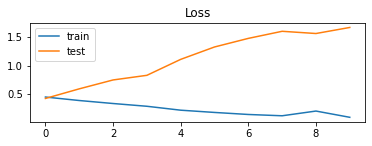

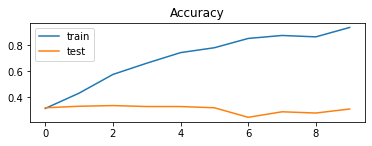

In [ ]:
pyplot.subplot(211)
pyplot.title('Loss')
pyplot.plot(hist.history['loss'], label='train')
pyplot.plot(hist.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

pyplot.subplot(211)
pyplot.title('Accuracy')
pyplot.plot(hist.history['acc'], label='train')
pyplot.plot(hist.history['val_acc'], label='test')
pyplot.legend()
pyplot.show()

## **Evaluation/Auto Prediction**

In [ ]:
developmentPrediction = model.evaluate(paddedDevData, devLabel, verbose=1)
print('Dev Prediction: ', np.round(developmentPrediction[1]*100, 2) ,' %')

30/30 [==============================] - 0s 11ms/step - loss: 1.6705 - acc: 0.3096
Dev Prediction:  30.96  %


## **Manual Prediction**

In [ ]:
yprime = model.predict(paddedDevData)
print('Predicted Label:\n\n',yprime) 
y = devLabel               
print('\nActual Label:\n\n',y)                

Predicted Label:

 [[0.         1.0351651  0.         0.         0.         0.        ]
 [0.         1.3264667  0.         0.         0.         0.        ]
 [0.         0.         0.35365492 0.08353703 0.1547797  0.03401059]
 ...
 [0.04286896 0.09270392 0.0788893  0.         0.07613789 0.2346521 ]
 [0.         0.40535694 0.09081315 0.         0.         0.3477465 ]
 [0.         0.1580292  0.14339194 0.         0.05064707 0.16732058]]

Actual Label:

 [[0 0 0 1 0 0]
 [0 0 0 1 0 0]
 [0 0 0 1 0 0]
 ...
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]
 [0 1 0 0 0 0]]


### Accuracy

In [ ]:
yprime = np.round(yprime.reshape(-1))
print('Predicted Output:\n', yprime)

y = np.round(y.reshape(-1))
print('actual Output:\n', y)

print('Accuracy Score: ',np.round(accuracy_score(y, yprime)*100 , 2), '%')

Predicted Output:
 [0. 1. 0. ... 0. 0. 0.]
actual Output:
 [0 0 0 ... 0 0 0]
Accuracy Score:  80.2 %


## **Confusion Matrix**

In [ ]:
expected = y
predicted = yprime
results = confusion_matrix(expected, predicted)
print(results)

[[4377  264   47   10    2]
 [ 787  146    6    1    0]
 [   0    0    0    0    0]
 [   0    0    0    0    0]
 [   0    0    0    0    0]]


## **F1 score**


In [ ]:
f1 = f1_score(y, yprime,average='micro')
print('F1 score: %f' % f1)

F1 score: 0.801950
